# Checklist
- [ ] label cluster
- [ ] generate umap w/ cell types and project back to brain proj

In [89]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
import os
import sys
current_path = os.getcwd()
parent_directory = os.path.dirname(current_path)
sys.path.append(parent_directory)
from Class.jenie import Jenie
import pandas as pd
import numpy as np
import scanpy as sc
import anndata
import umap.umap_ as umap
import leidenalg
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from sklearn.cluster import KMeans
from scipy.spatial.distance import pdist, squareform
from sklearn.metrics import pairwise_distances
from scipy.stats import zscore
from matplotlib.colorbar import ColorbarBase
import matplotlib.colors as mcolors
from umap import UMAP
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import silhouette_score
from kneed import KneeLocator
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import ParameterGrid

In [3]:
plt.style.use('dark_background')

### Read in data

In [4]:
edu_pos_scdata = sc.read_h5ad(r"C:\Users\krist\Cleveland Lab Group\activation_of_quiescent_neurogenic_niches_of_aging_brain\4_week_edu_pos.h5ad")
edu_pos_scdata

AnnData object with n_obs × n_vars = 5143 × 275
    obs: 'volm', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'edu_median', 'edu_mean', 'edu_pos', 'leiden', 'celltype', 'x', 'cluster_names'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'umap', 'x_colors'
    obsm: 'X_pca', 'X_raw', 'X_spatial', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [5]:
umap_operator = umap.UMAP(n_components = 2, random_state = 42, metric = 'euclidean')
umap_result_edupos = umap_operator.fit_transform(edu_pos_scdata.obsm['X_pca'])

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\umap\umap_.py:1945: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(f"n_jobs value {self.n_jobs} overridden to 1 by setting random_state. Use no seed for parallelism.")


In [6]:
edu_pos_scdata.obsm['X_umap'] = umap_result_edupos

In [7]:
sc.pp.neighbors(edu_pos_scdata)
sc.tl.leiden(edu_pos_scdata, resolution = 1.25)

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


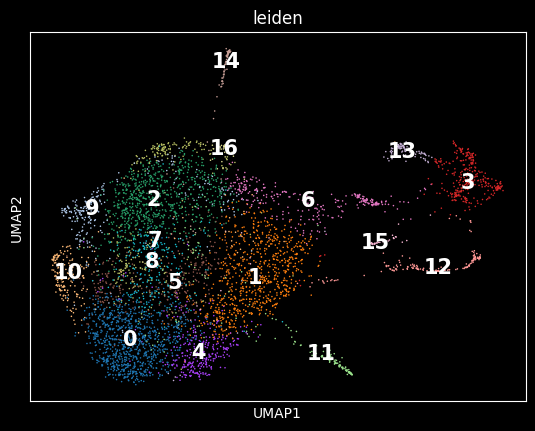

In [8]:
sc.pl.umap(edu_pos_scdata, color = 'leiden', legend_loc = 'on data', size = 5, legend_fontsize = 15)

### Brain Proj map per cluster

In [16]:
edu_scdata = sc.read_h5ad(r"C:\Users\krist\Cleveland Lab Group\activation_of_quiescent_neurogenic_niches_of_aging_brain\4week_mouse_edu_labeled_onlyOB.h5ad")
edu_scdata

AnnData object with n_obs × n_vars = 49170 × 275
    obs: 'volm', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'edu_median', 'edu_mean', 'edu_pos', 'leiden', 'celltype', 'x'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts'
    uns: 'celltype_colors', 'leiden', 'log1p', 'neighbors', 'umap', 'x_colors'
    obsm: 'X_raw', 'X_spatial', 'X_umap'
    obsp: 'connectivities', 'distances'

In [76]:
adata_edu_pos = Jenie(edu_pos_scdata, 'edu_pos_scdata', 'edu_pos_scdata', pallete = 'edu_pos_4_week_ob_relabeled')

In [19]:
adata_edu= Jenie(edu_scdata, 'edu_scdata', 'edu_scdata', pallete = 'color_dict')

In [15]:
leiden_list = list(edu_pos_scdata.obs['leiden'].unique())
leiden_list

['11',
 '16',
 '1',
 '4',
 '6',
 '14',
 '3',
 '12',
 '2',
 '7',
 '0',
 '10',
 '5',
 '9',
 '8',
 '15',
 '13']

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that 

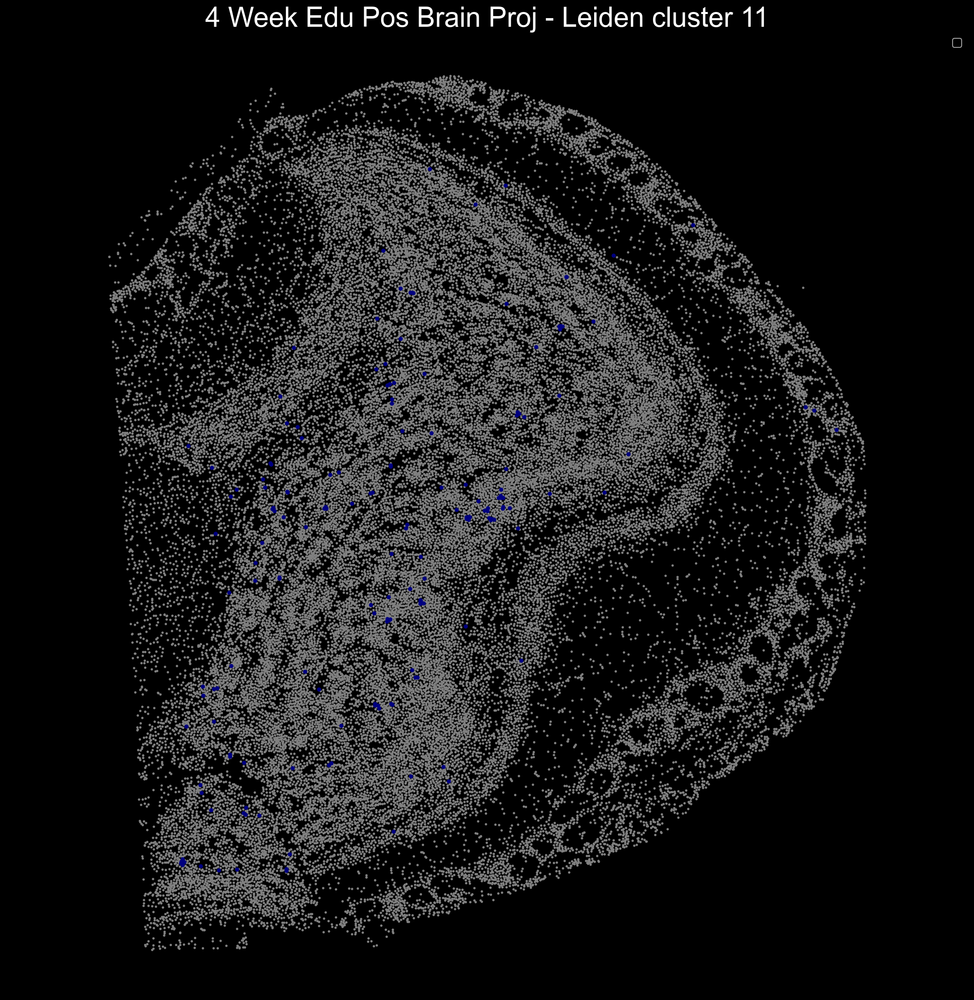

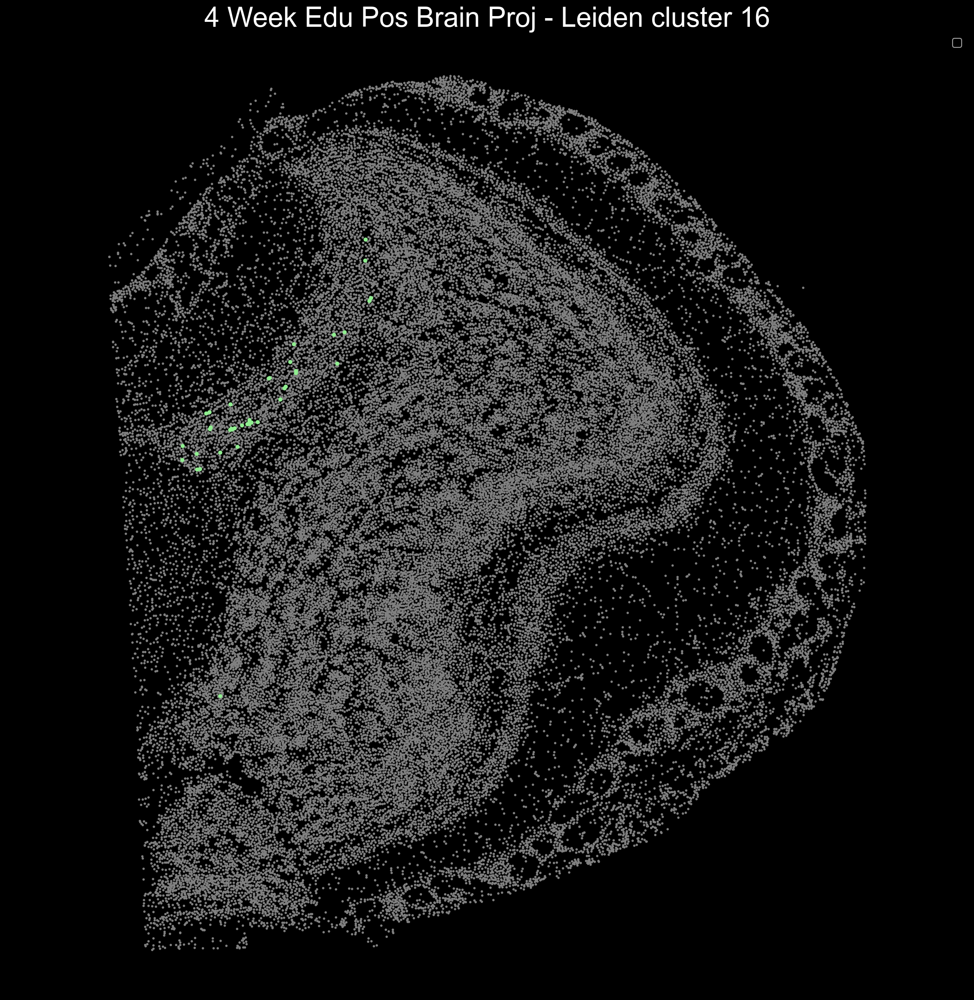

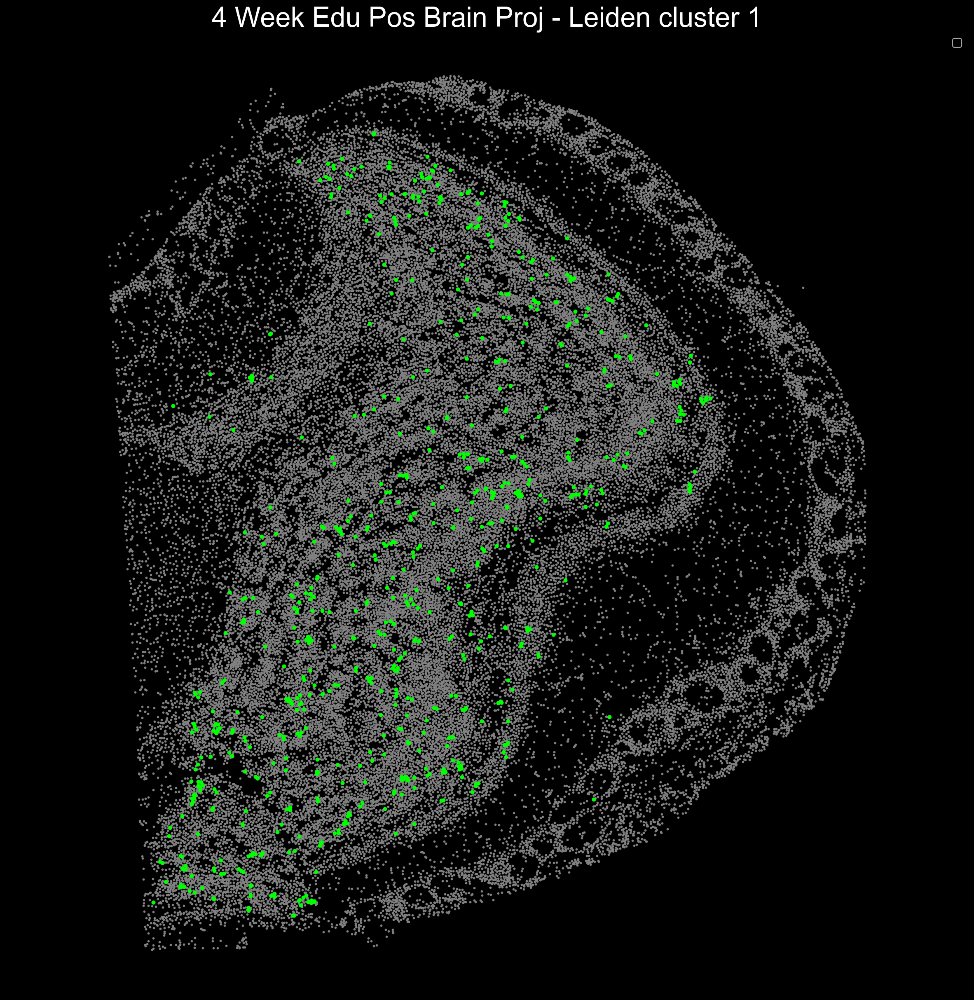

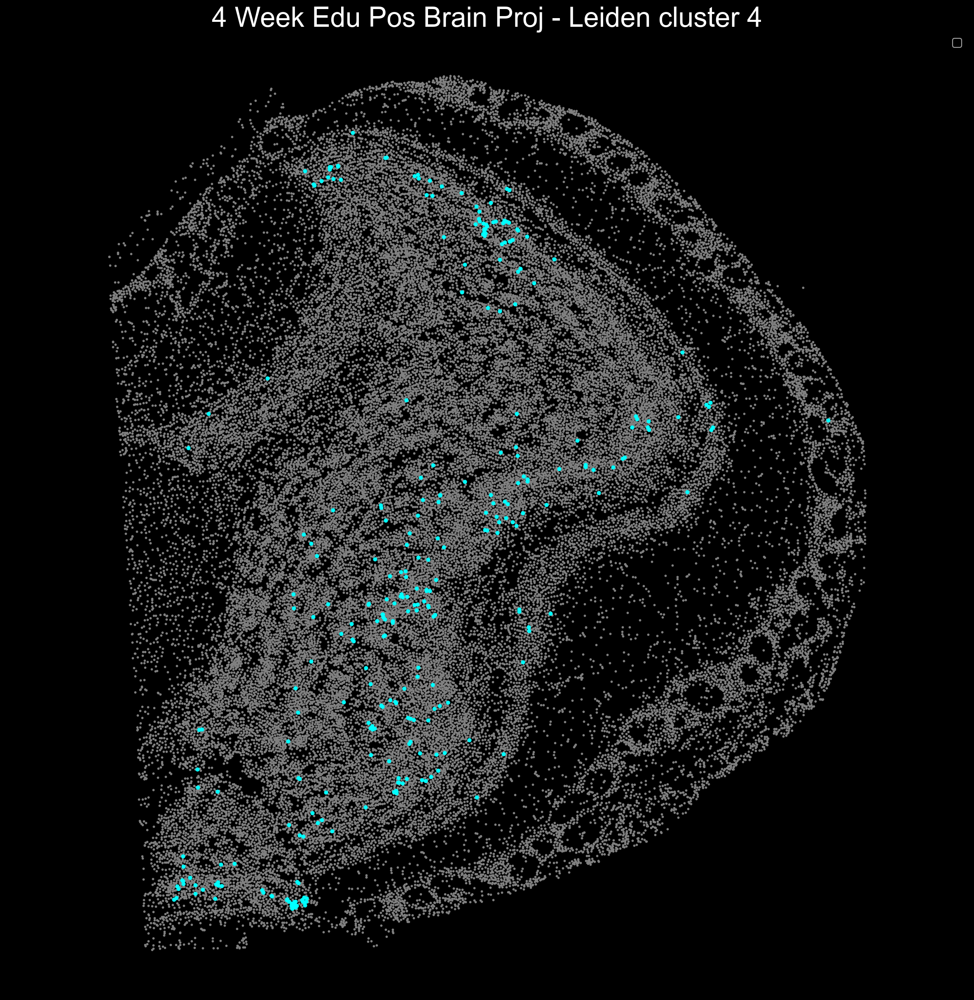

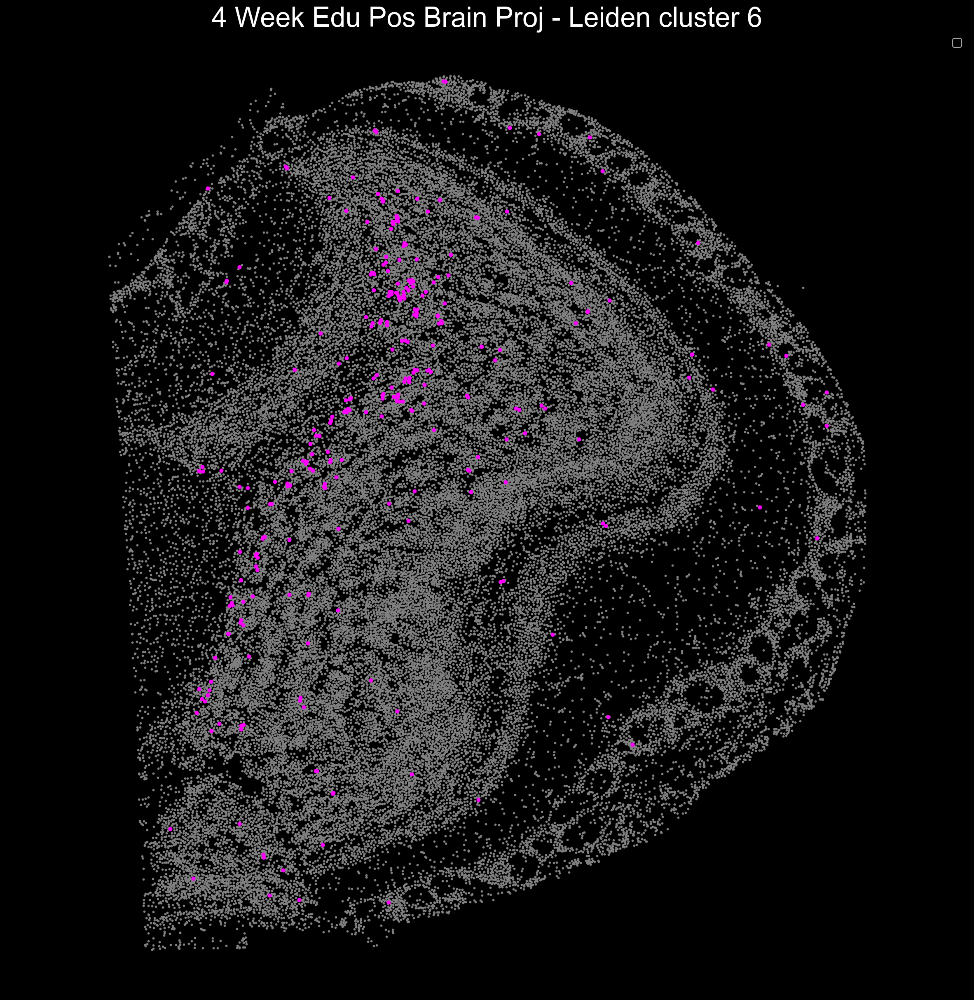

...

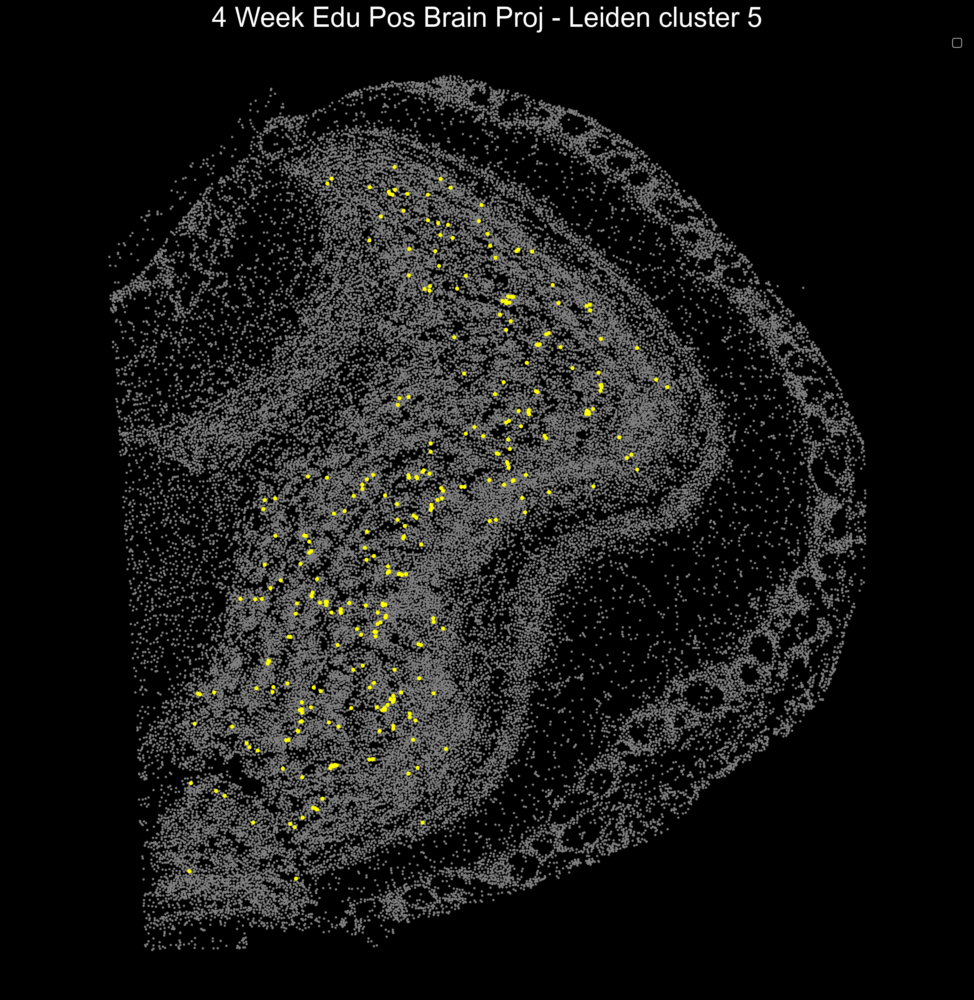

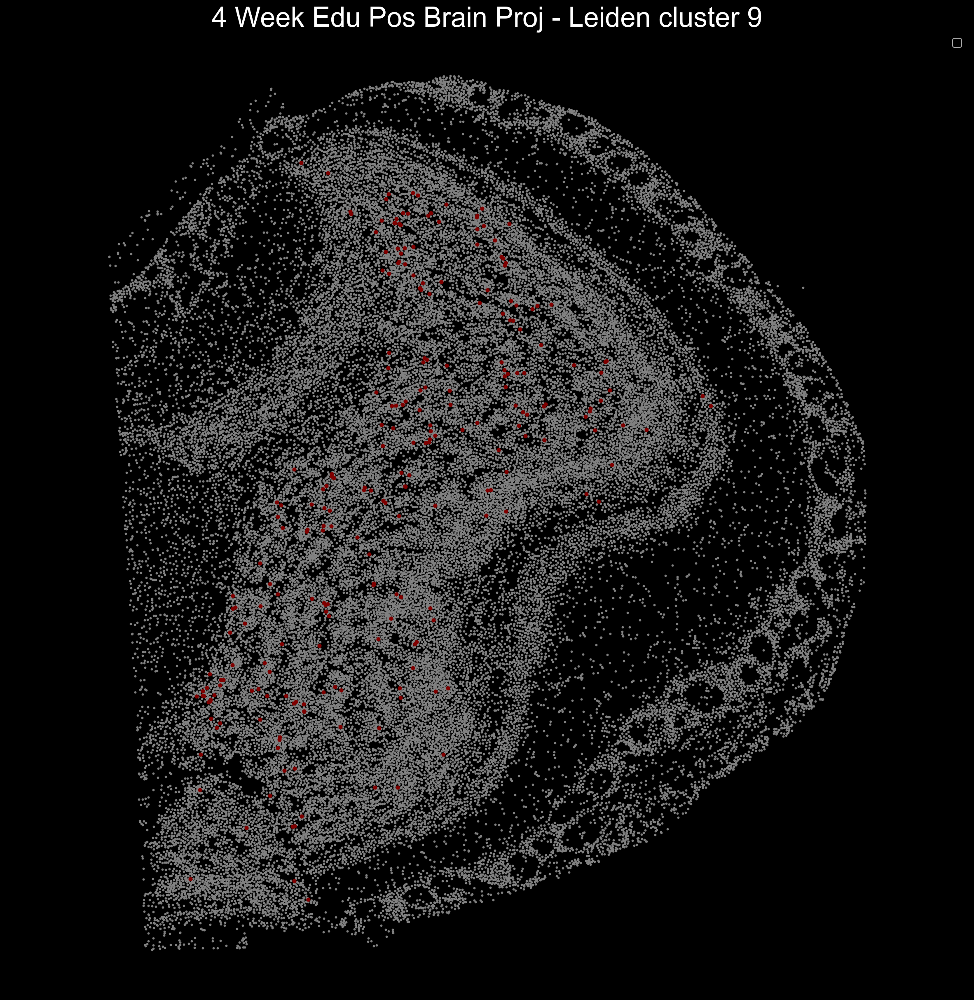

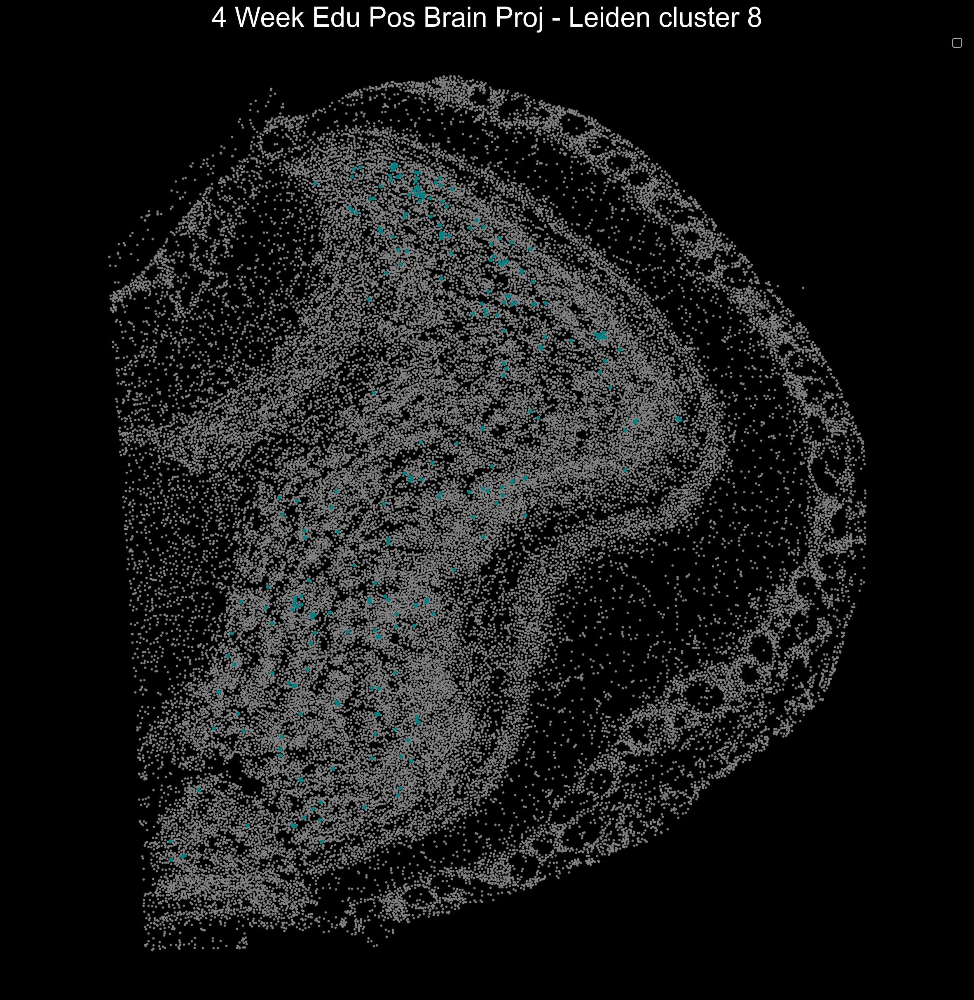

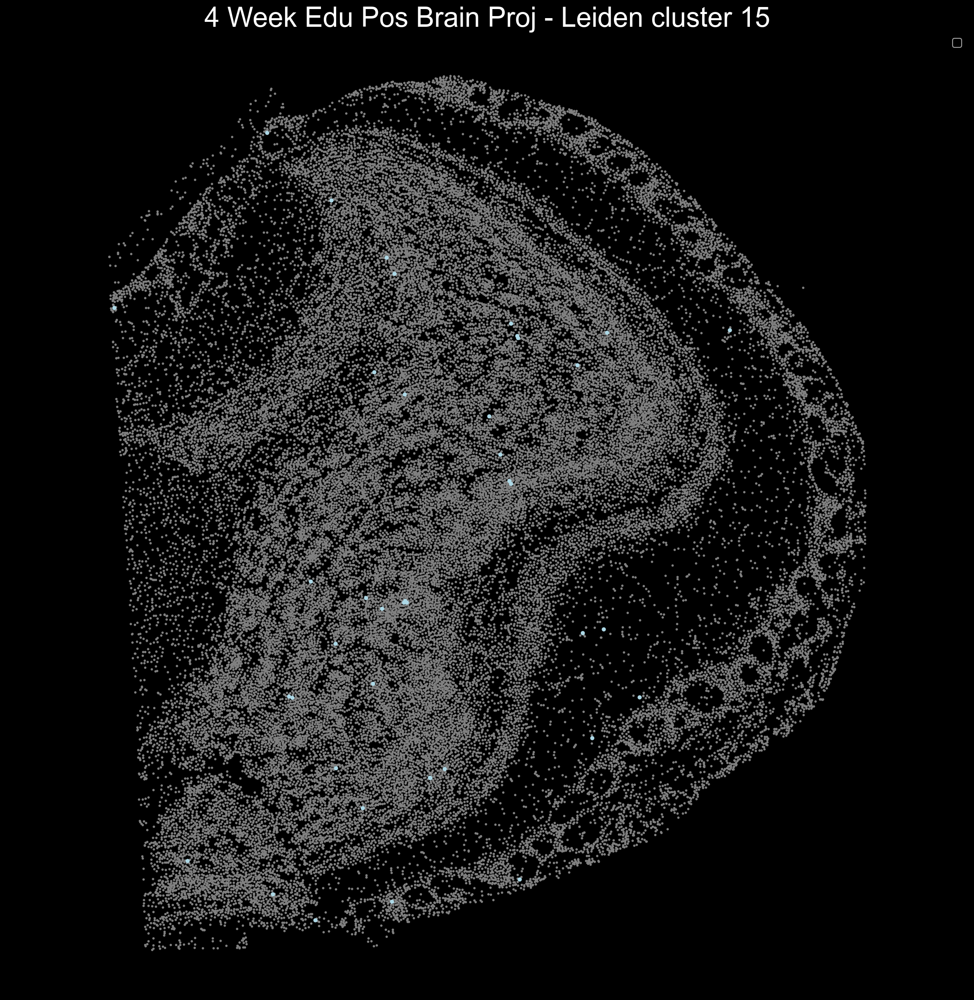

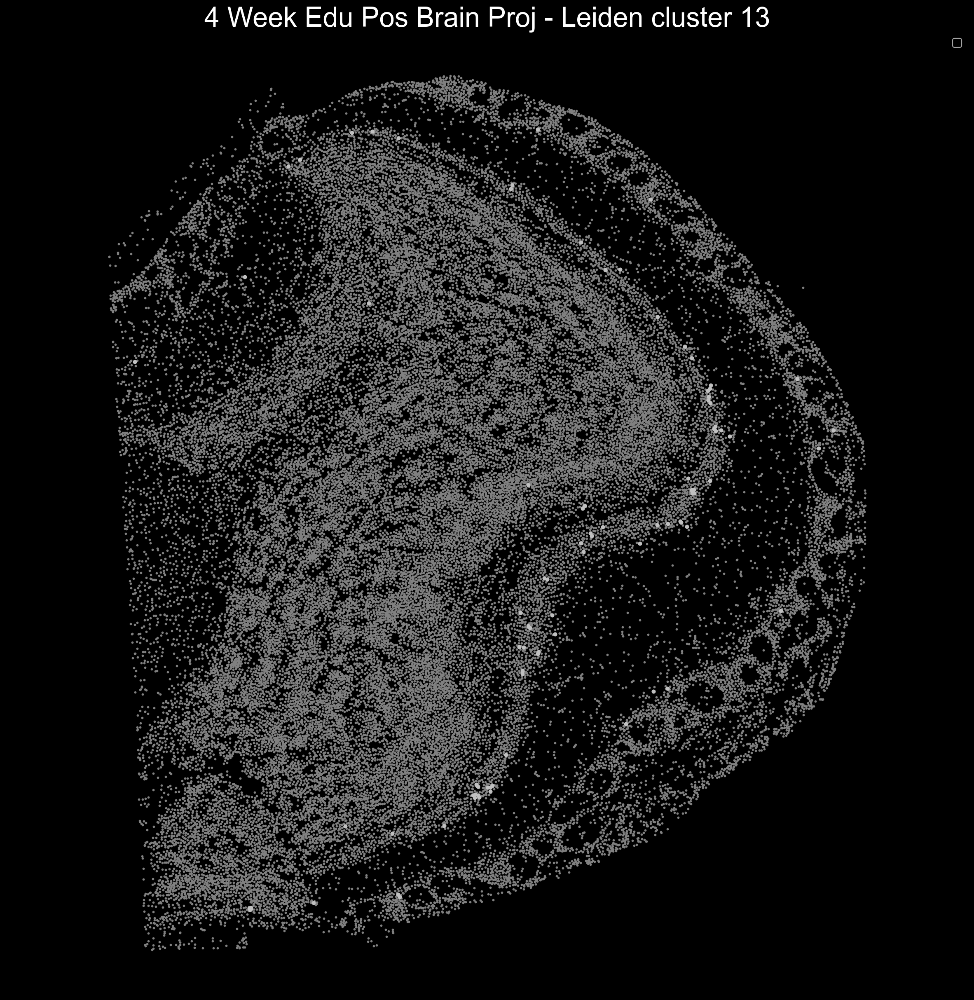

In [22]:
for leiden in leiden_list:
    adata_edu_pos.plot_cluster_scdata(group = 'leiden', clusters = [leiden], ref = adata_edu, sbig = 50, ssm = 10)
    plt.title(f'4 Week Edu Pos Brain Proj - Leiden cluster {leiden}', fontsize = 30)

### Plot gene expression bar chart

In [27]:
sc.tl.rank_genes_groups(edu_pos_scdata, groupby = 'leiden', method = 'wilcoxon')

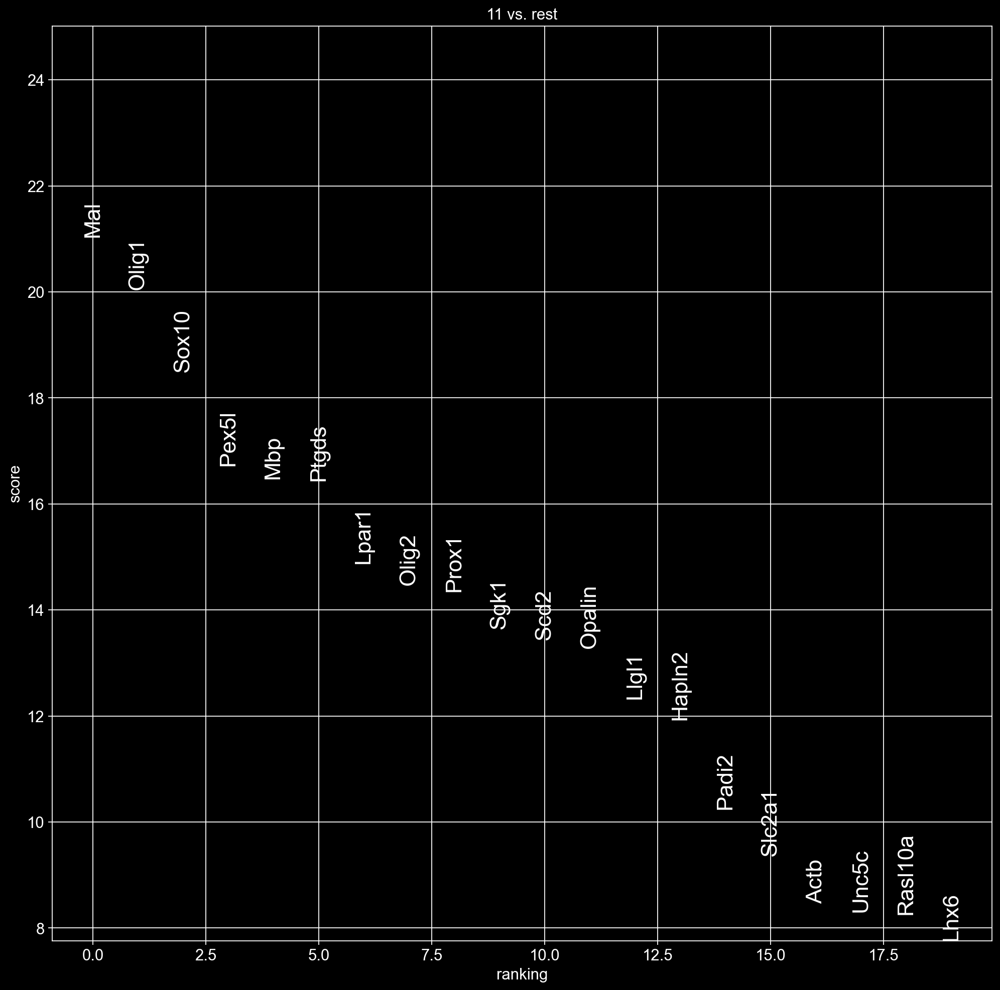

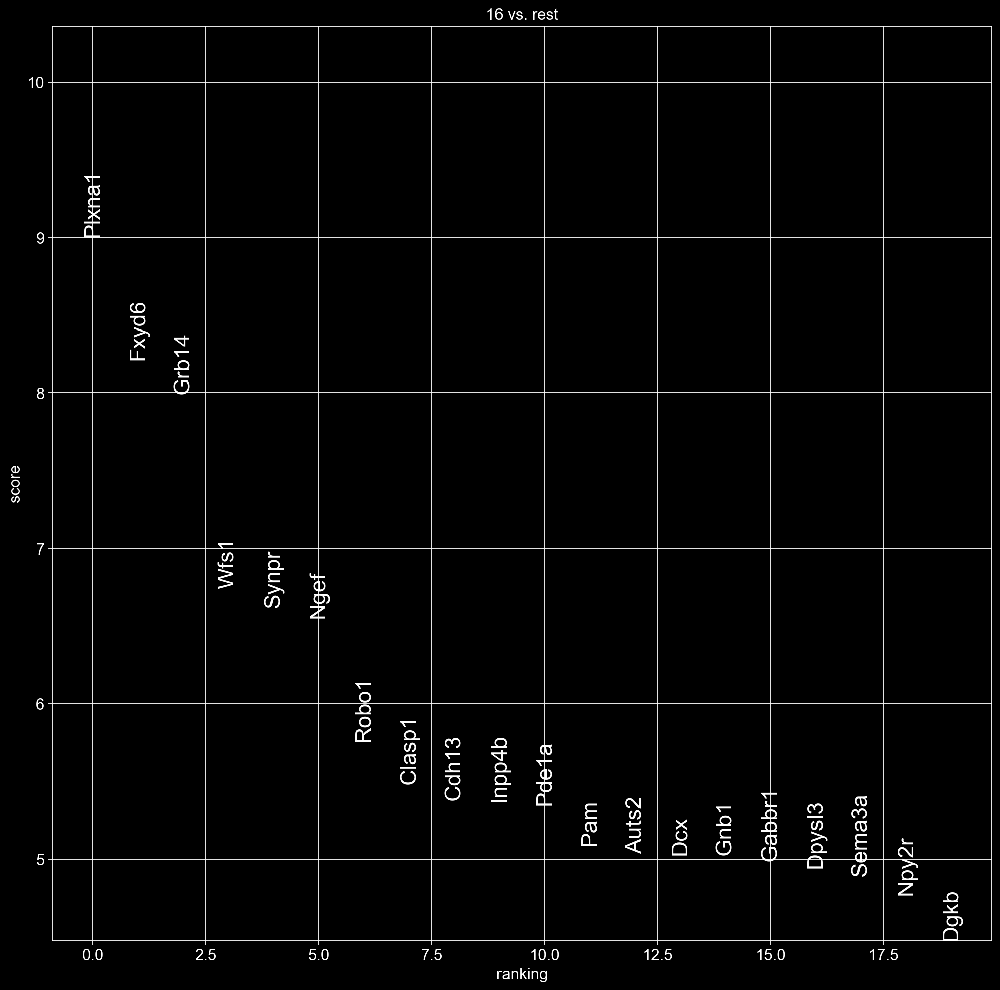

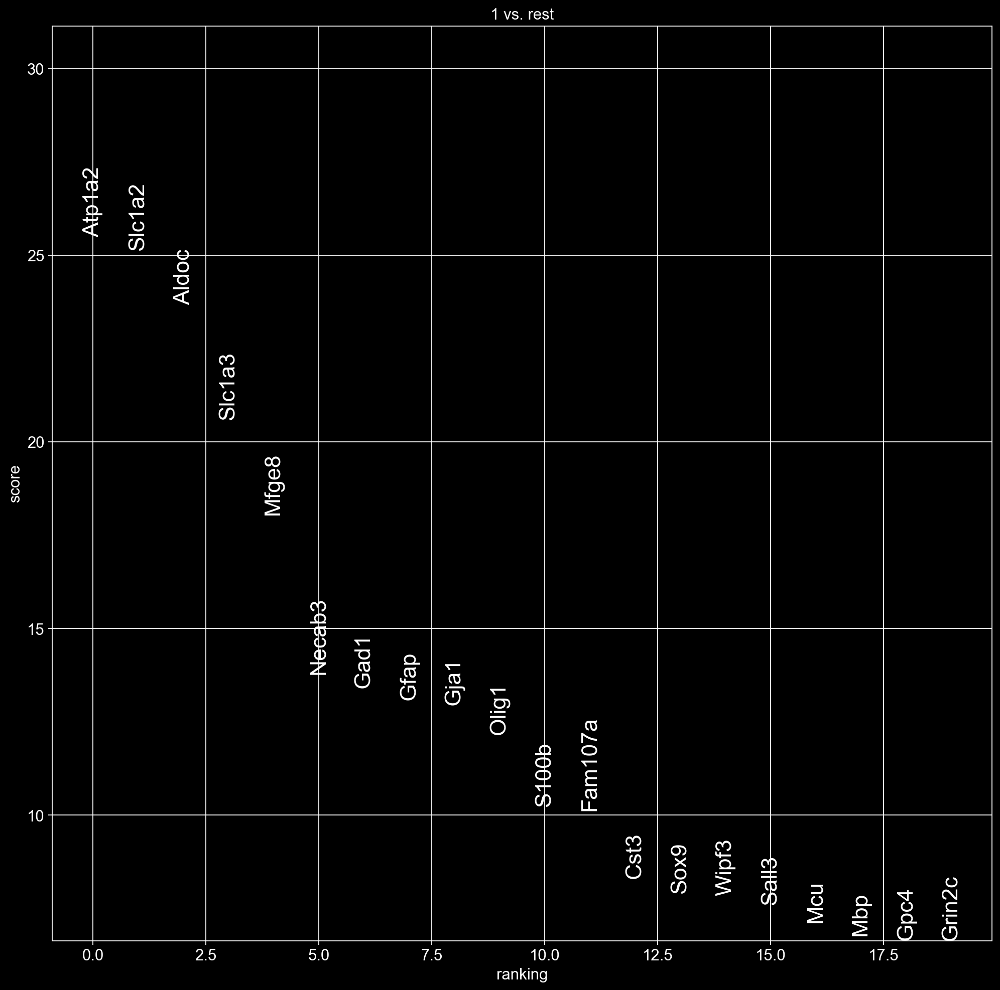

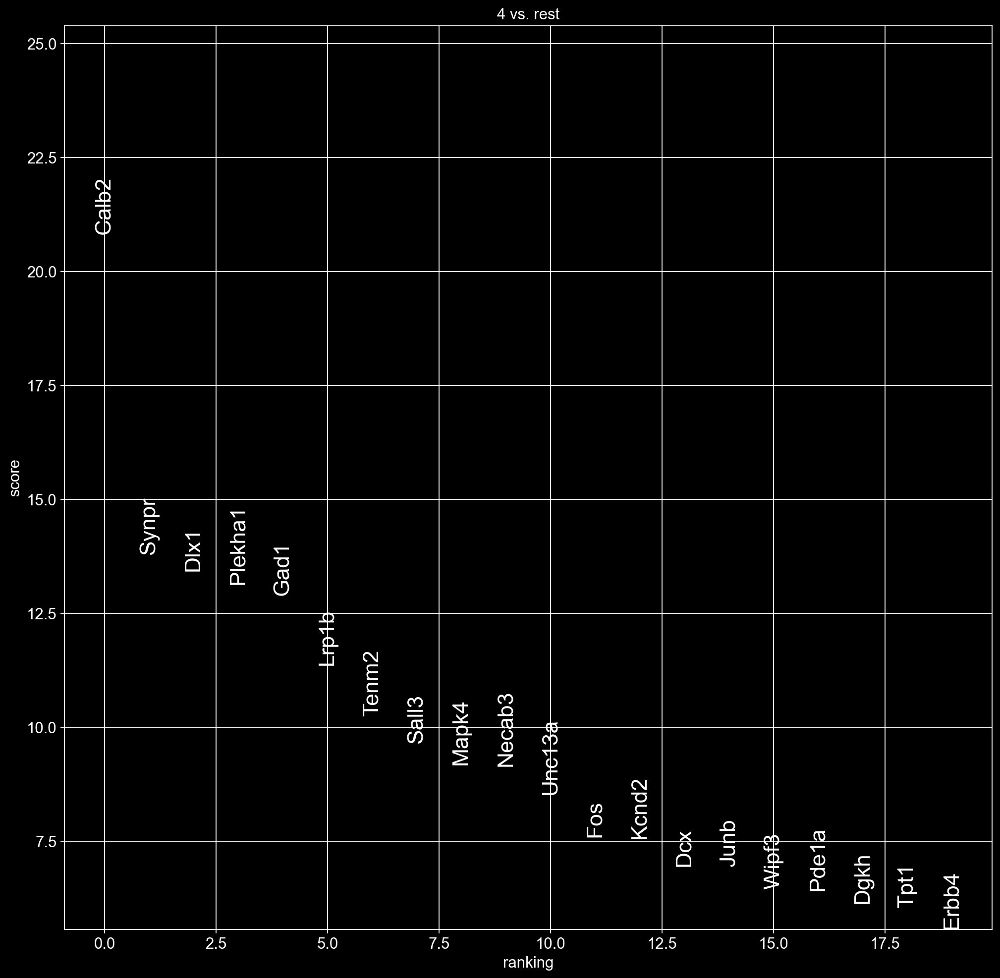

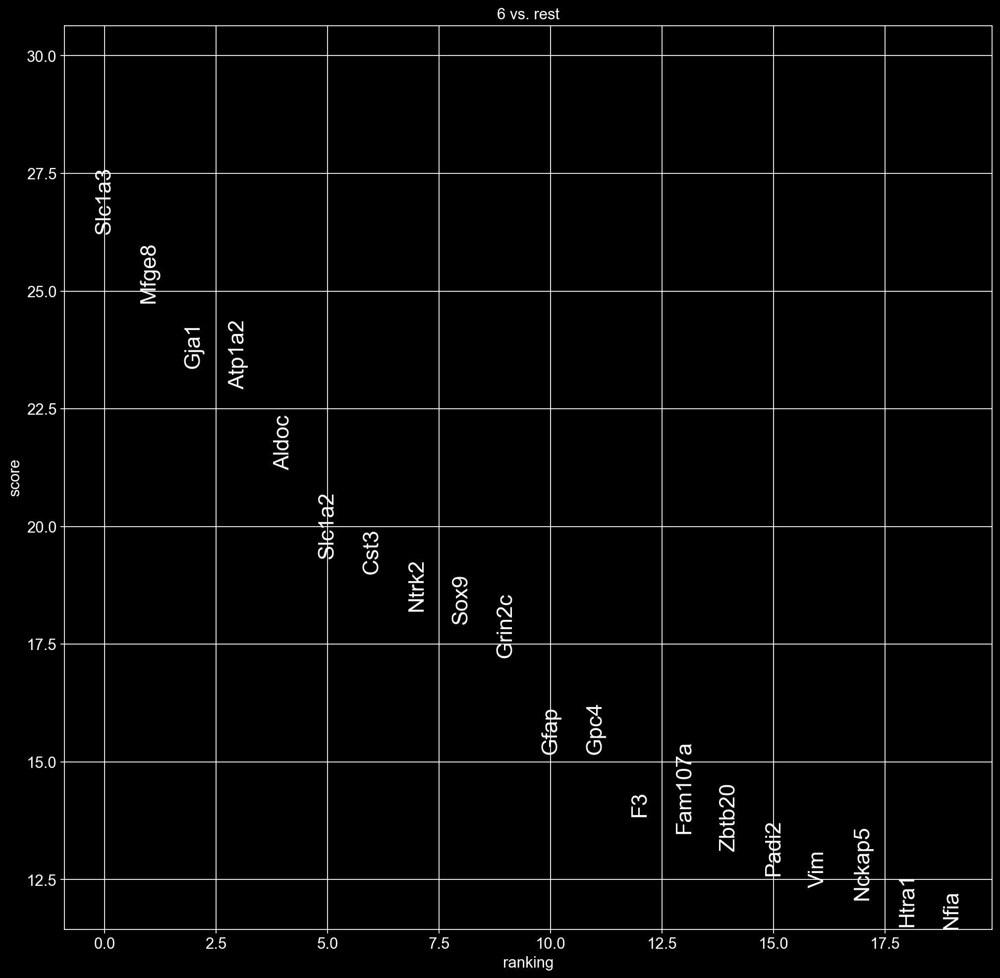

...

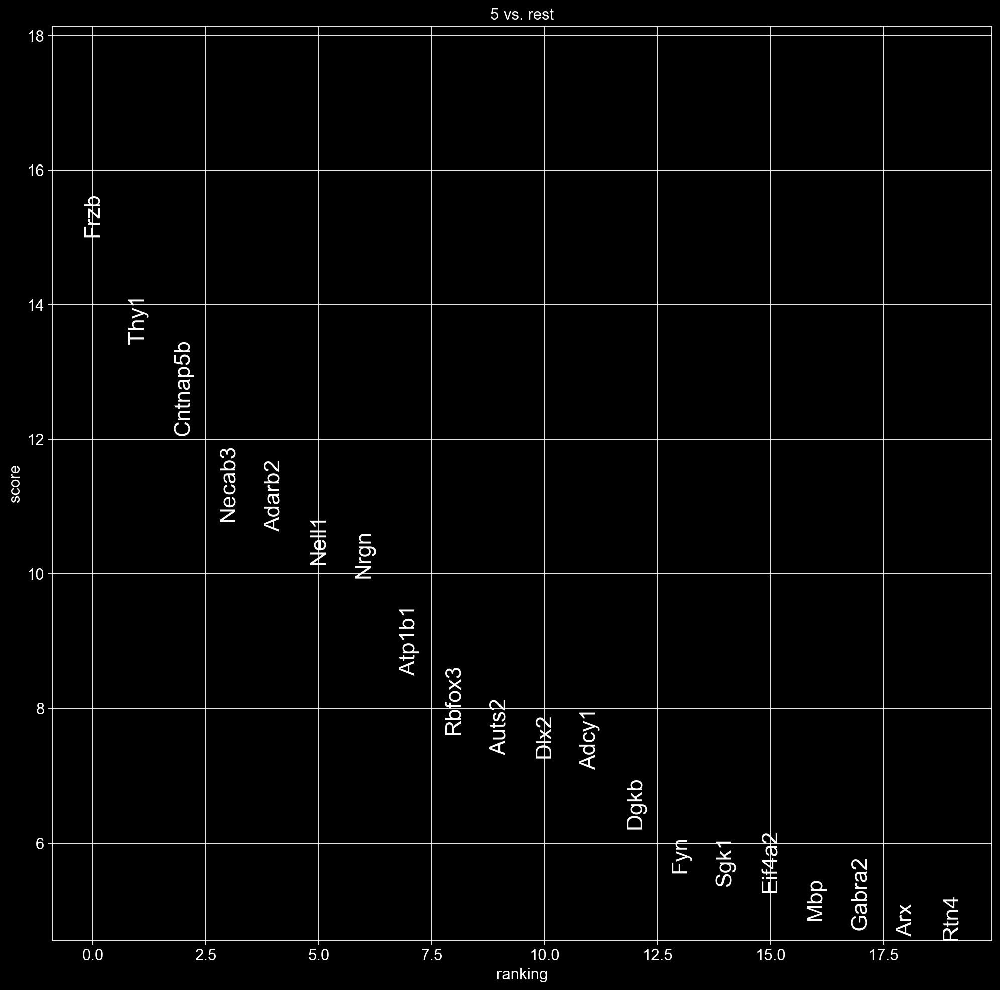

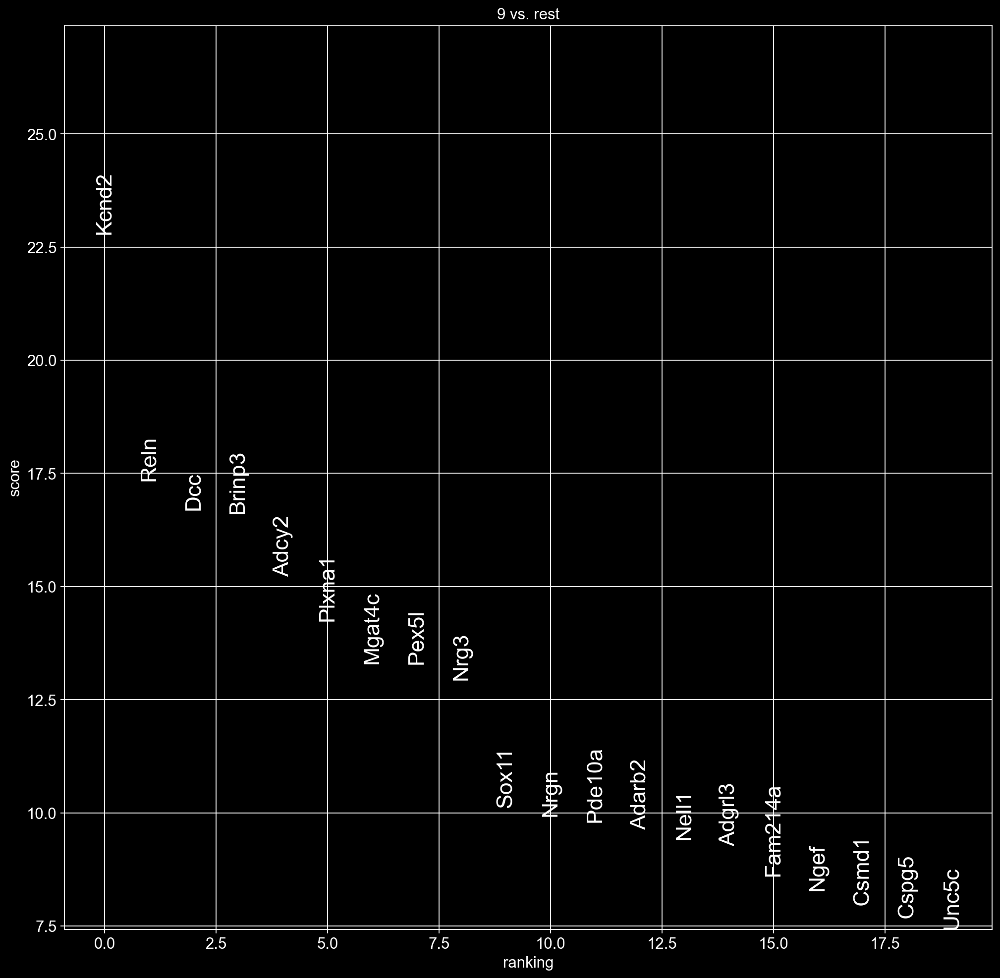

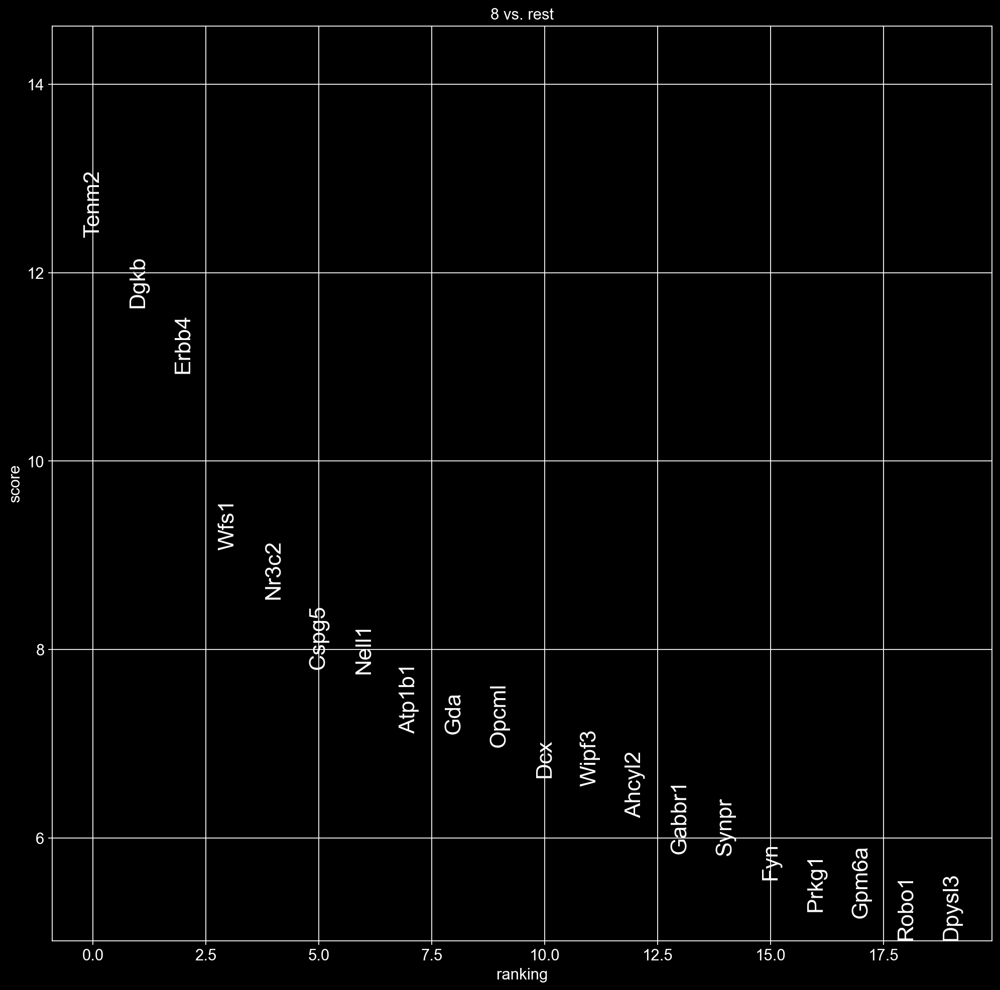

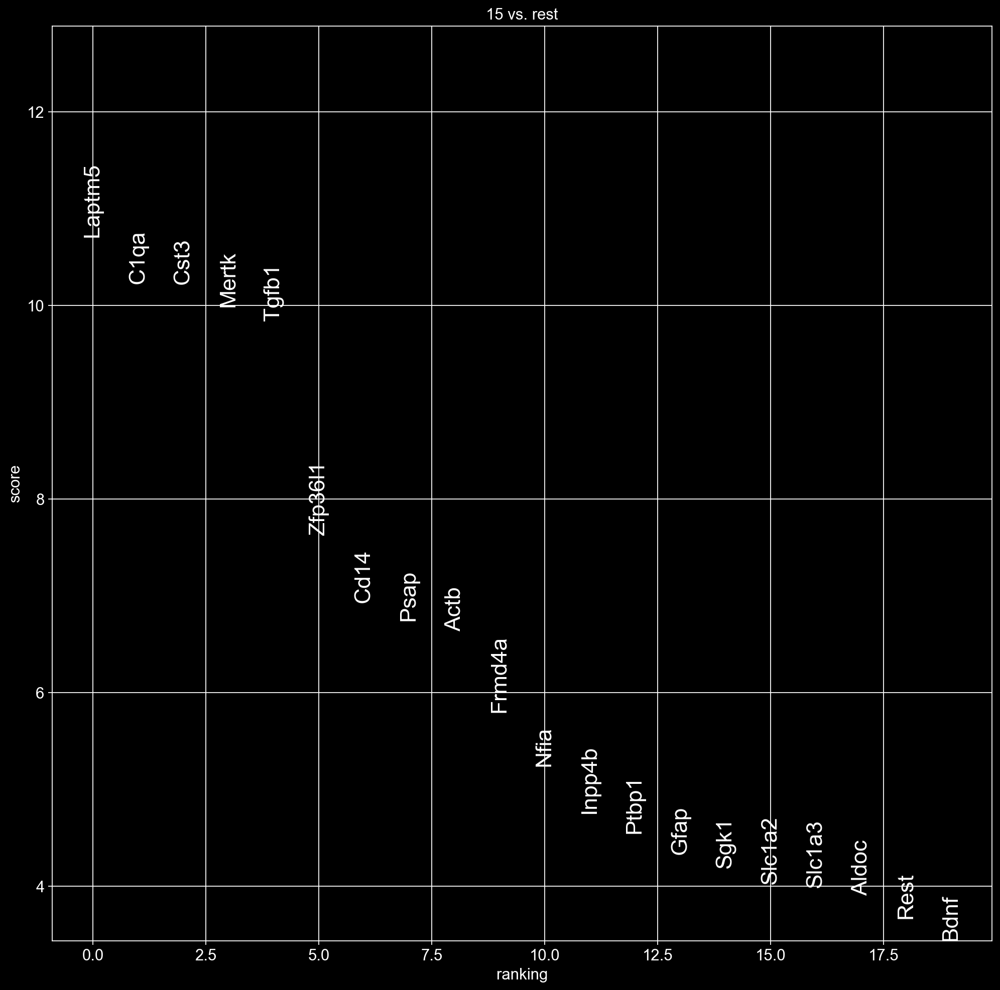

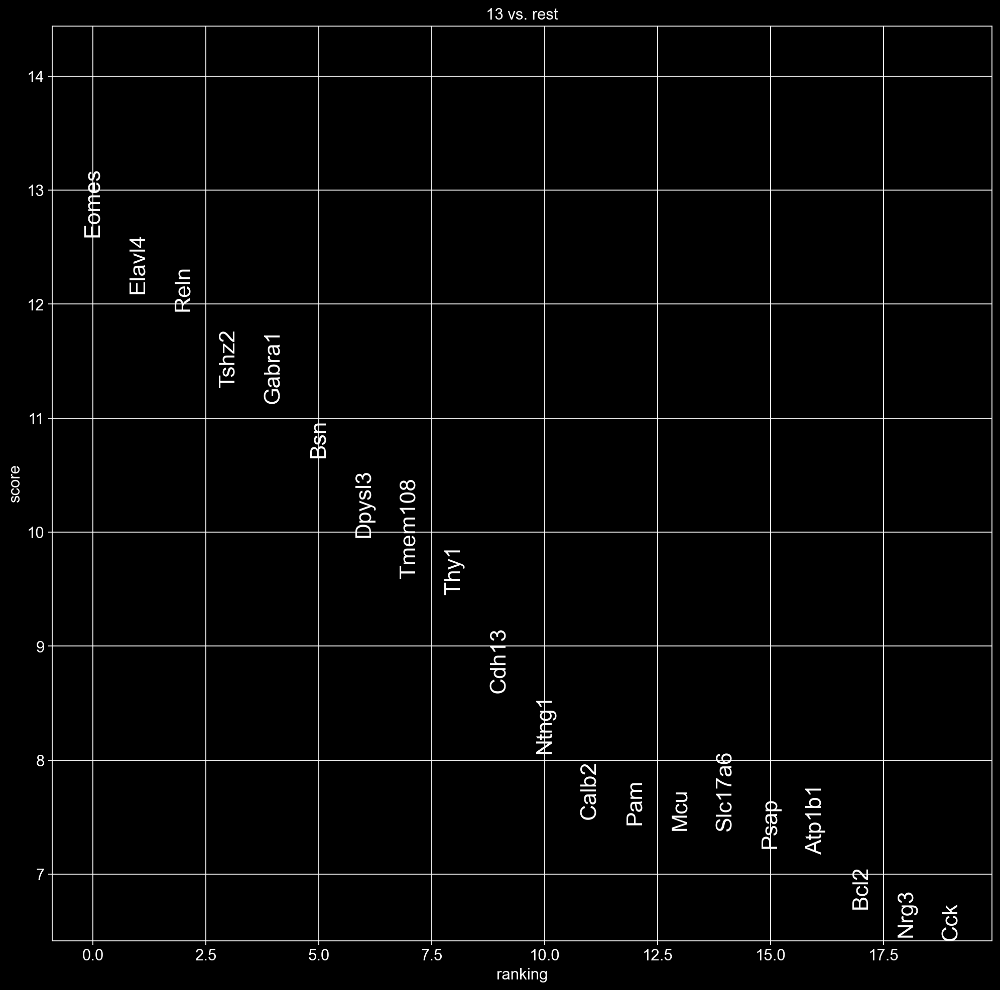

In [55]:
for leiden in leiden_list:
    sc.pl.rank_genes_groups(edu_pos_scdata, groups = [leiden], fontsize = 20)

### Map Cell types

In [65]:
edu_pos_cluster_name_mapping = {
    '0': 'GABAergic neurons',
    '1': 'Astro',
    '2': 'More mature neuron',
    '3': 'Astro',
    '4': 'Immature neuron',
    '5': 'Immature neuron',
    '6': 'Astro',
    '7': 'Super immature neuron',
    '8': 'Neuron',
    '9': 'Neuron',
    '10': 'Neuron',
    '11': 'Oligo',
    '12': 'Vim positive glia',
    '13': 'Neural progenitors',
    '14': 'OPC',
    '15': 'Microglia',
    '16': 'Neurons'
}

In [67]:
# Convert category keys in the dictionary to strings
edu_pos_cluster_name_mapping = {str(k): v for k, v in edu_pos_cluster_name_mapping.items()}

# Map cluster IDs to cluster names using the updated dictionary
edu_pos_scdata.obs['cluster_names'] = edu_pos_scdata.obs['leiden'].astype(str).map(edu_pos_cluster_name_mapping)

In [69]:
edu_pos_celltype_list = list(edu_pos_scdata.obs['cluster_names'].unique())
len(edu_pos_celltype_list)

12

In [70]:
edu_pos_color_dict =  {
        "0": "#07ba7f",
        "1": "#00FF00",
        "2": "#0000FF",
        "3": "#7B68EE",
        "4": "#00FFFF",
        "5": "#FFFF00",
        "6": "#FF00FF",
        "7": "#FF7A00",
        "8": "#008080",
        "9": "#800000",
        "10": "#008000",
        "11": "#000080",
        "12": "#808080",
        "13": "#C0C0C0",
        "14": "#FFA500"
}

In [71]:
edu_pos_color_list = edu_pos_color_dict.values()
edu_pos_color_list

dict_values(['#07ba7f', '#00FF00', '#0000FF', '#7B68EE', '#00FFFF', '#FFFF00', '#FF00FF', '#FF7A00', '#008080', '#800000', '#008000', '#000080', '#808080', '#C0C0C0', '#FFA500'])

In [72]:
import json
edu_pos_dict = {}
for celltype, color in zip(edu_pos_celltype_list, edu_pos_color_list):
    edu_pos_dict[celltype] = color
edu_pos_dict = json.dumps(edu_pos_dict)
edu_pos_dict

'{"Oligo": "#07ba7f", "Neurons": "#00FF00", "Astro": "#0000FF", "Immature neuron": "#7B68EE", "OPC": "#00FFFF", "Vim positive glia": "#FFFF00", "More mature neuron": "#FF00FF", "Super immature neuron": "#FF7A00", "GABAergic neurons": "#008080", "Neuron": "#800000", "Microglia": "#008000", "Neural progenitors": "#000080"}'

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


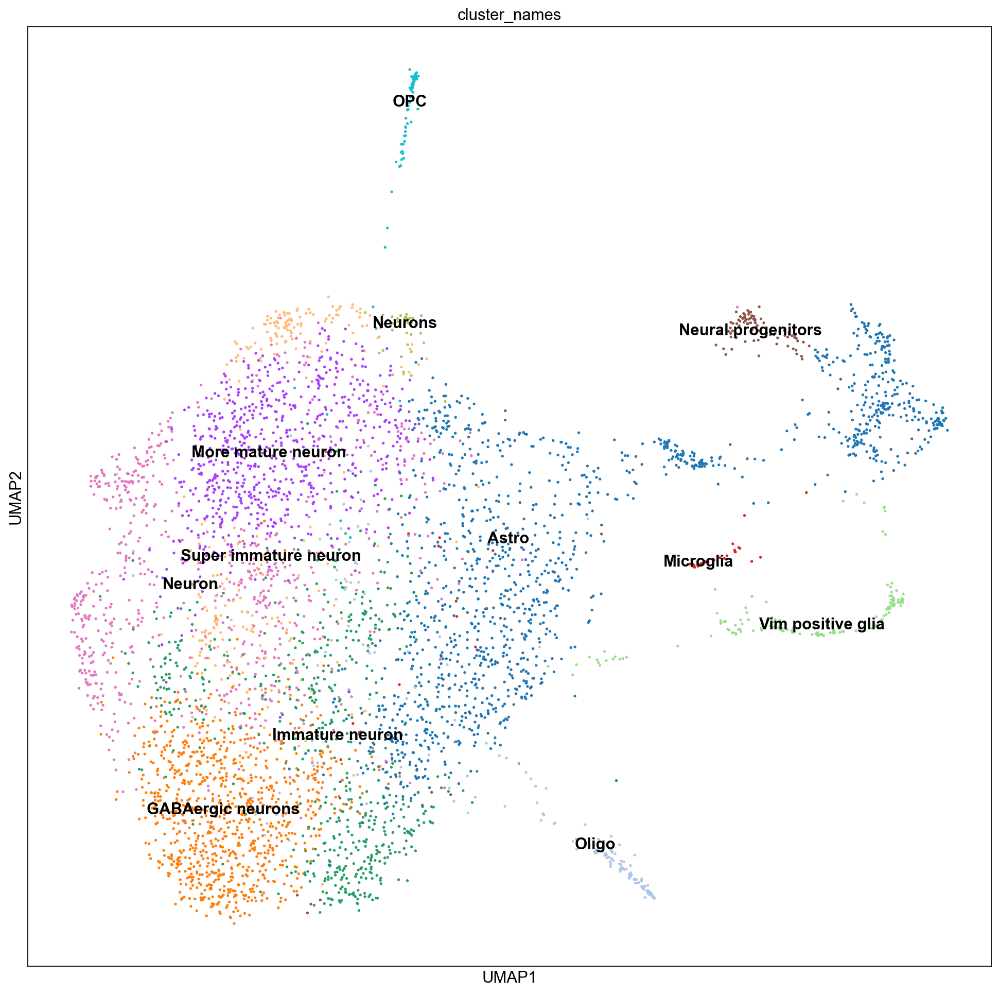

In [74]:
sc.pl.umap(edu_pos_scdata, color = 'cluster_names', legend_loc = 'on data')

C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:371: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:381: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
C:\Users\krist\AppData\Local\Programs\Python\Python311\Lib\site-packages\scanpy\plotting\_tools\scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


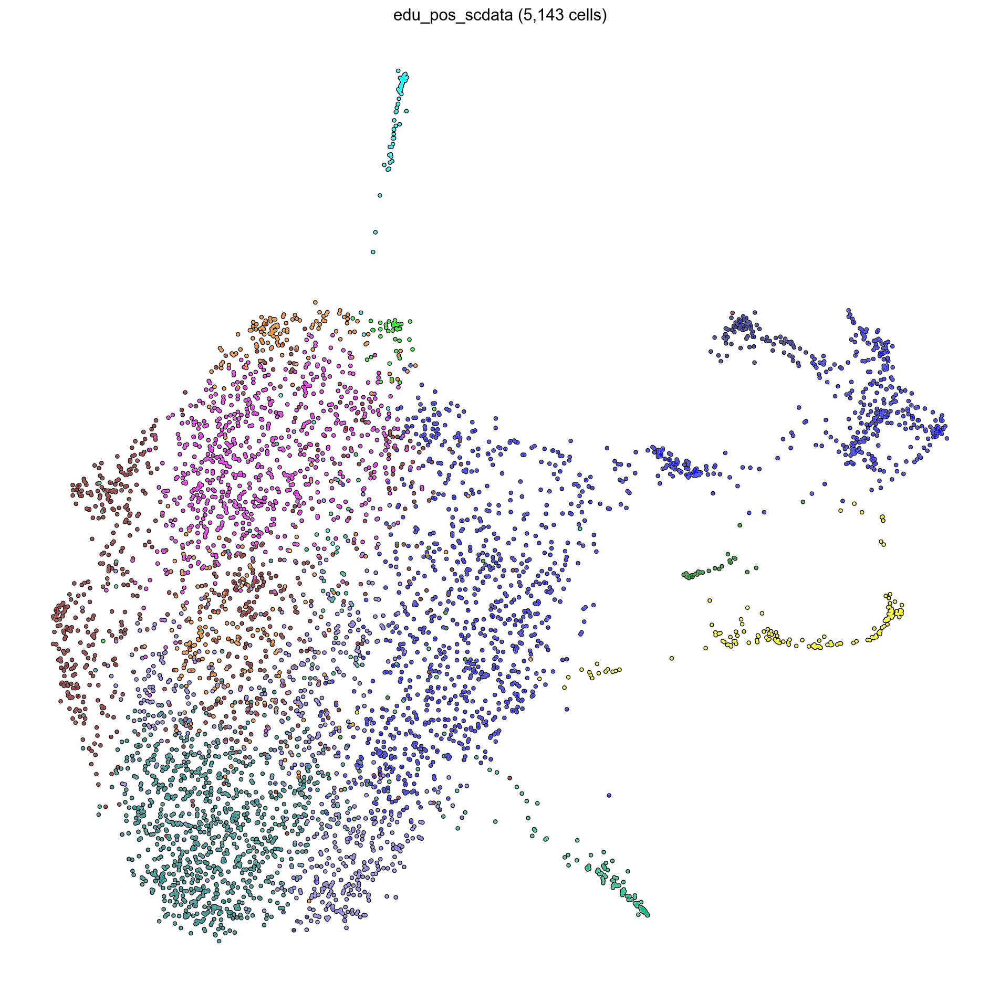

In [78]:
adata_edu_pos.umap(group = 'cluster_names')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


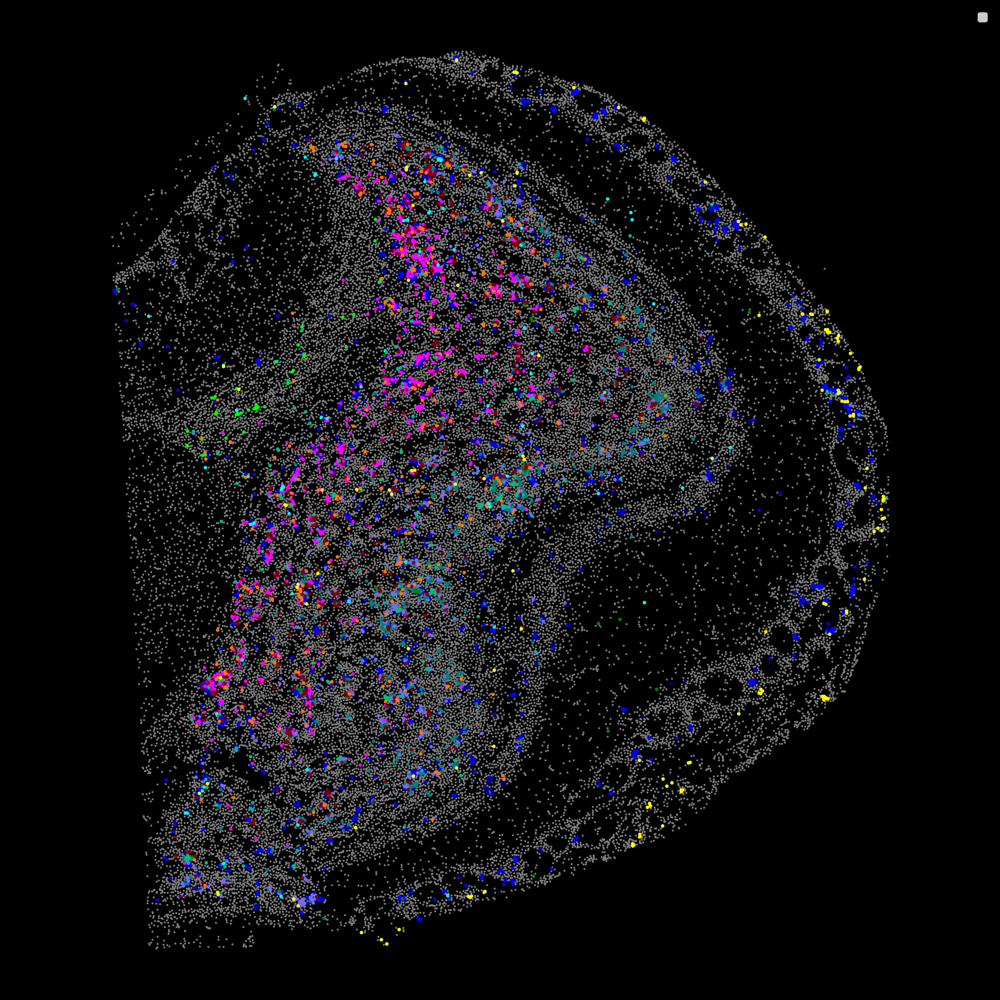

In [79]:
adata_edu_pos.plot_cluster_scdata(group = 'cluster_names', ref = adata_edu)

In [11]:
gene_list = ['Ascl1', 'Hes5', 'Mfge8', 'Nnat', 'Sox2', 'Sox9']

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


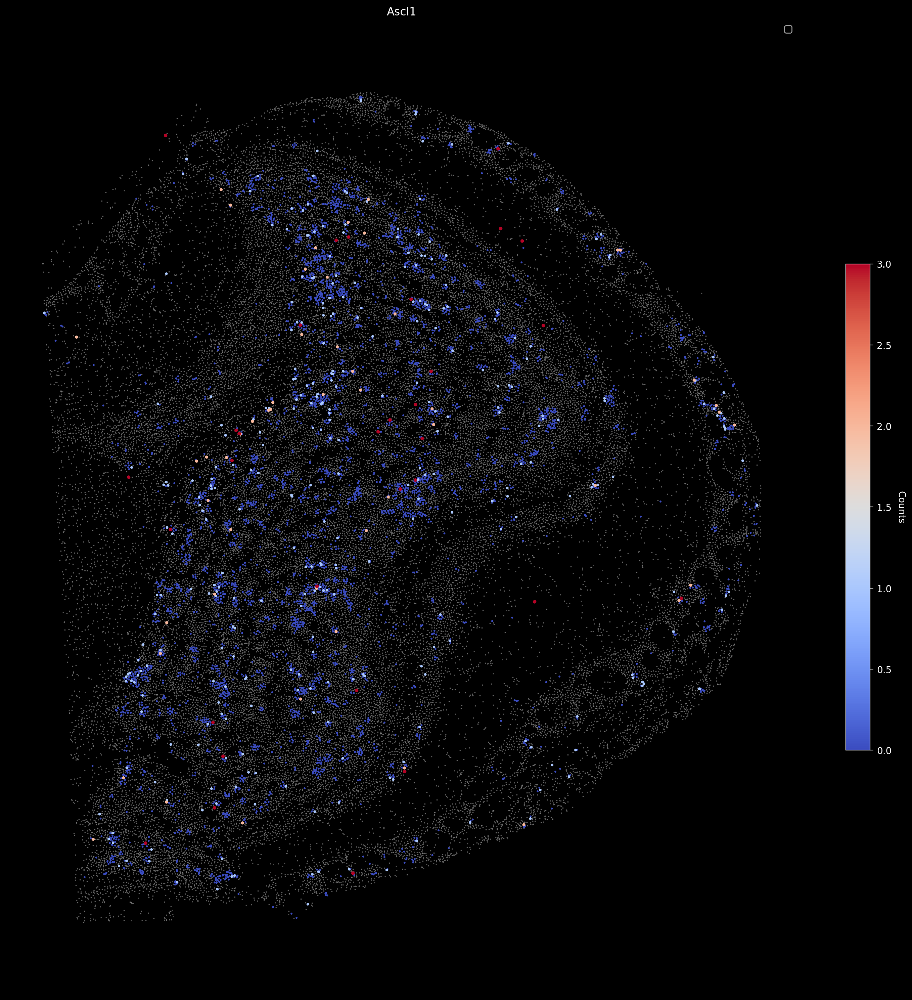

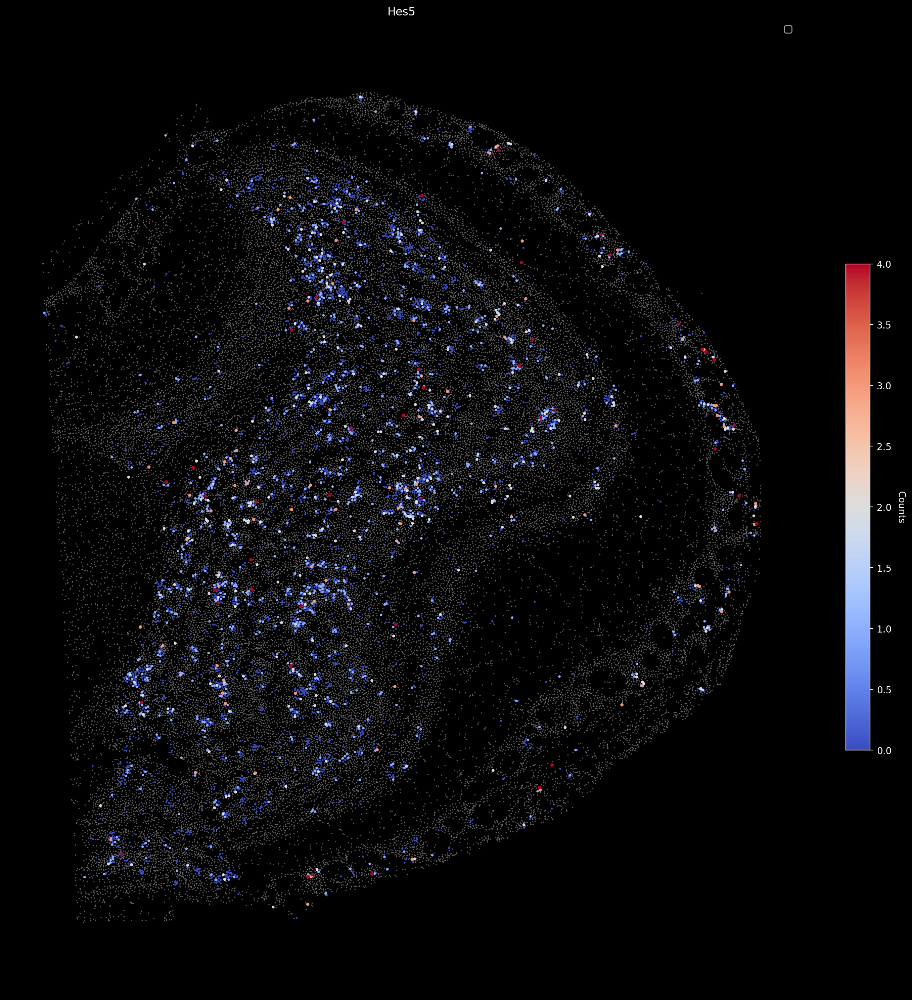

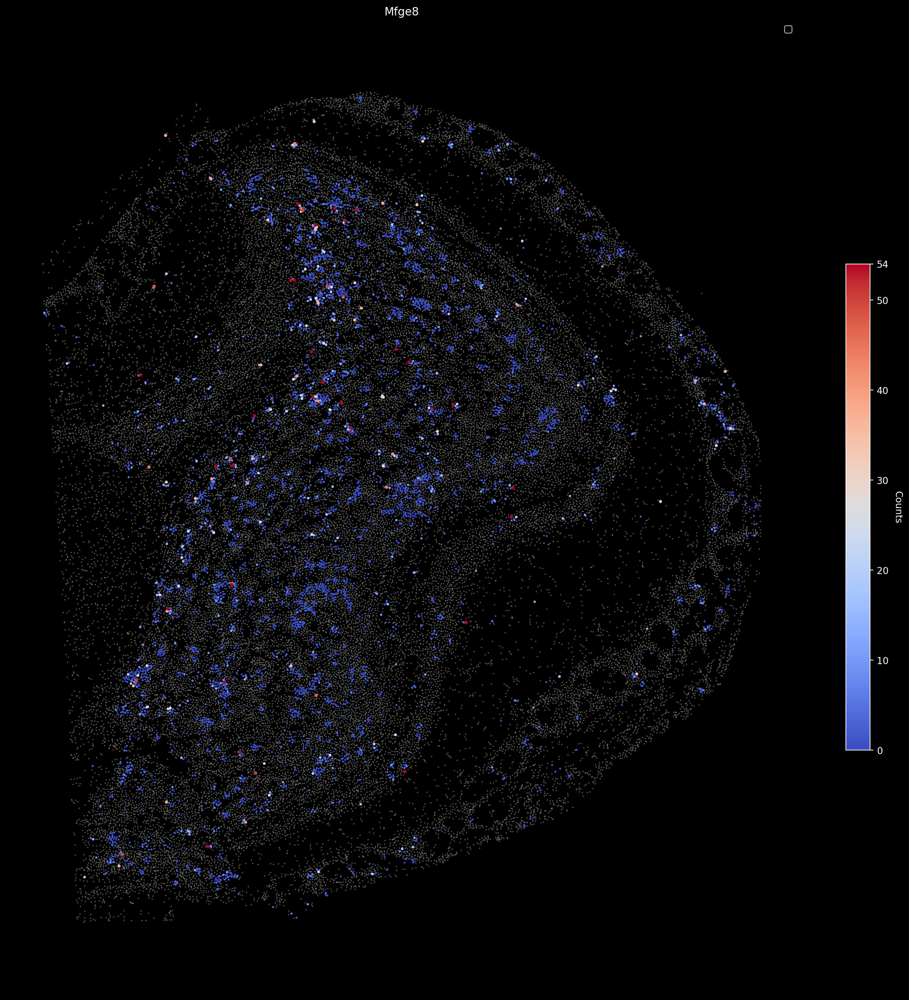

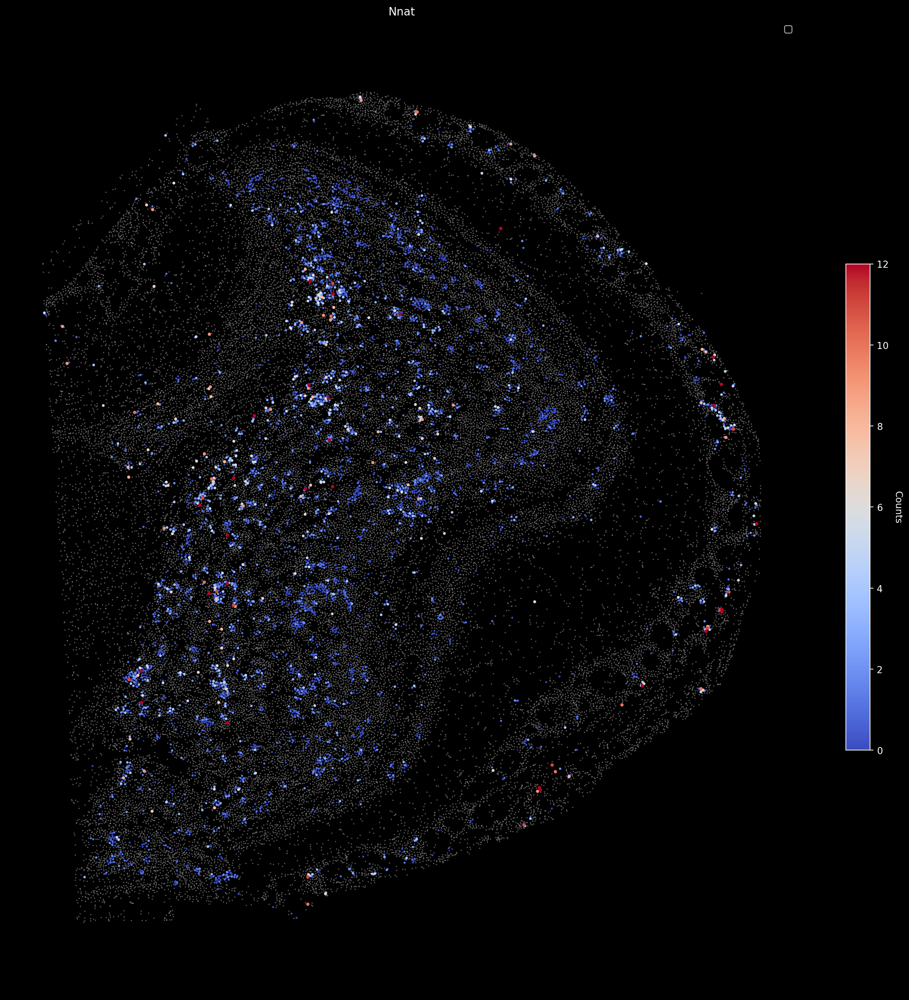

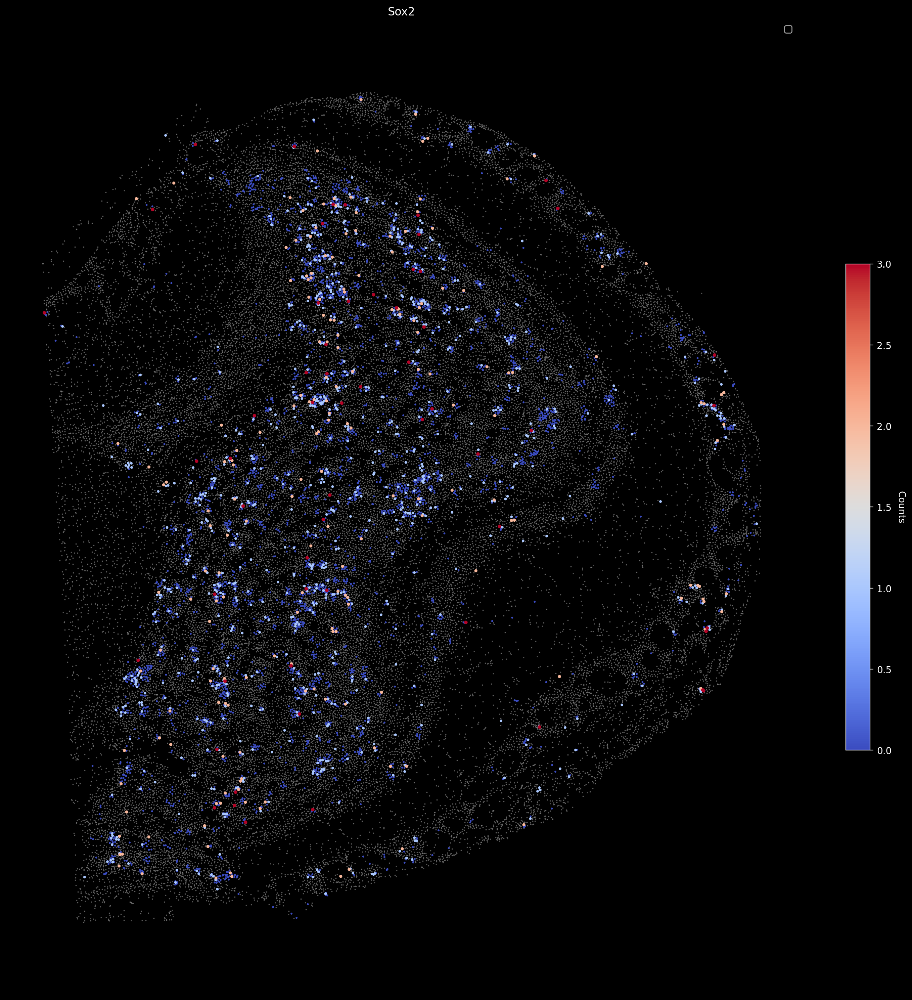

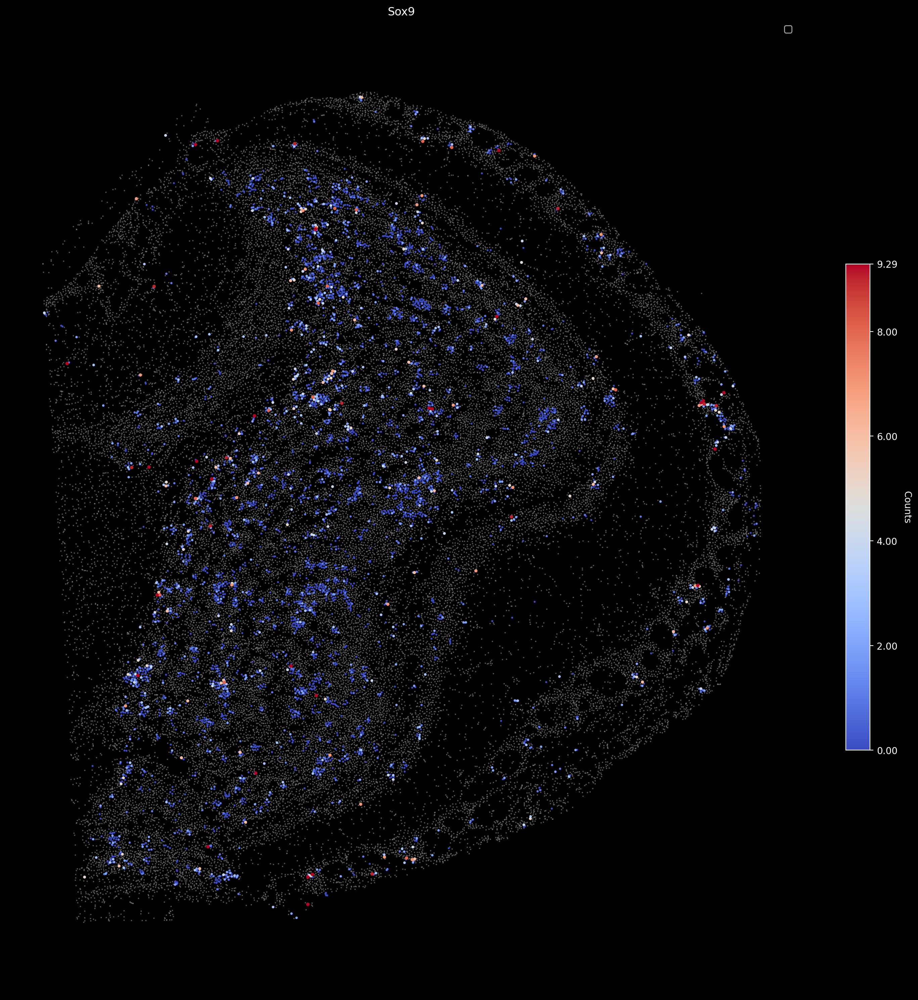

In [92]:
for gene in gene_list:
    adata_edu_pos.plot_gene_scdata(gene = gene, percentile = 99.5, ref = edu_scdata, bg = True, ssm = 0.1)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


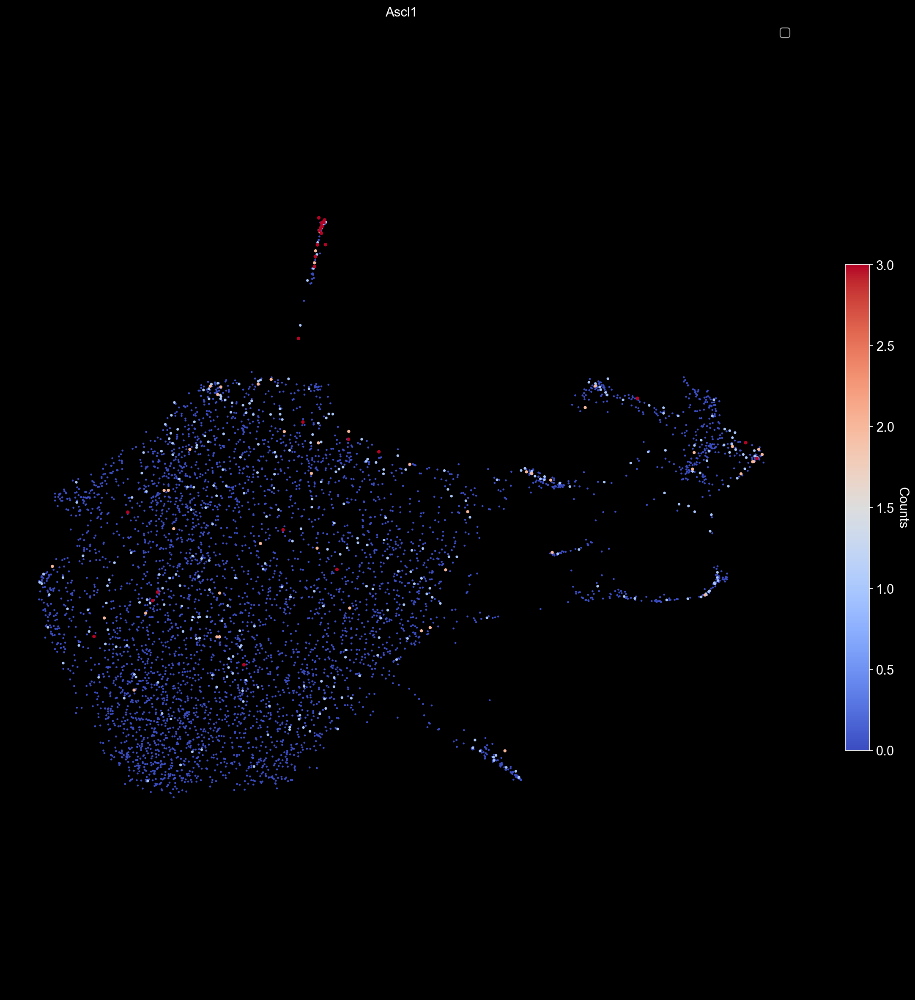

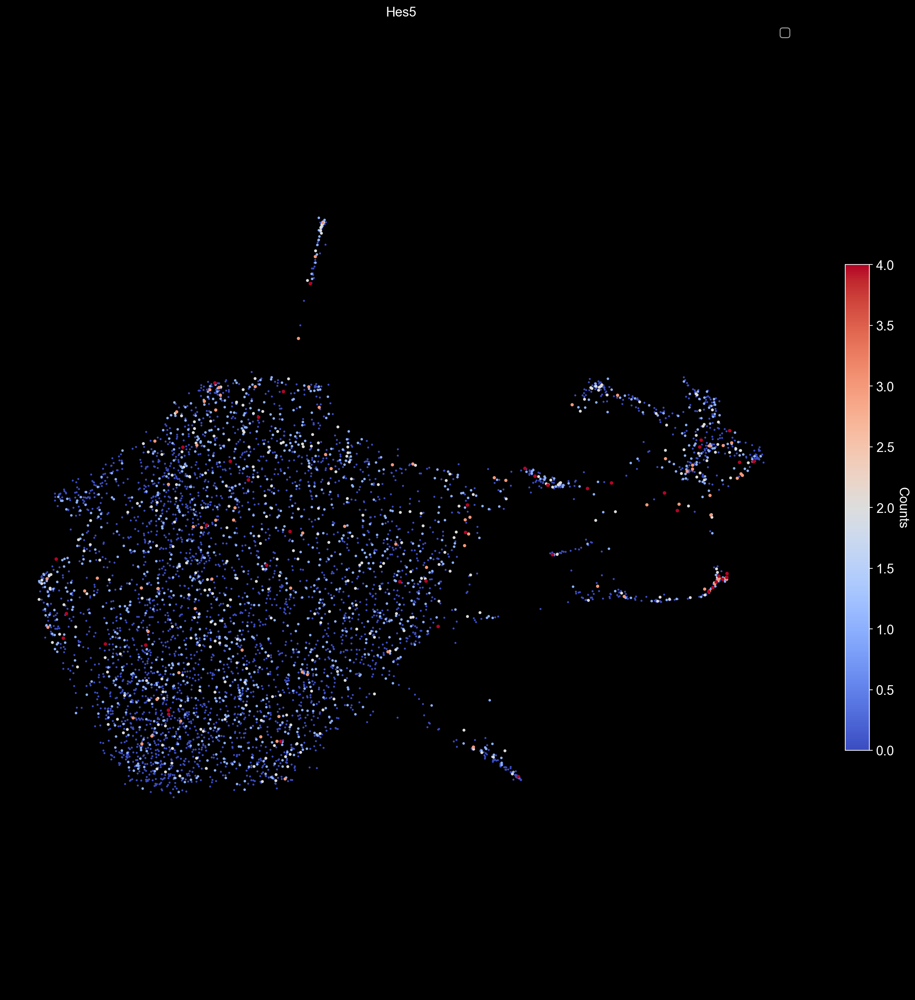

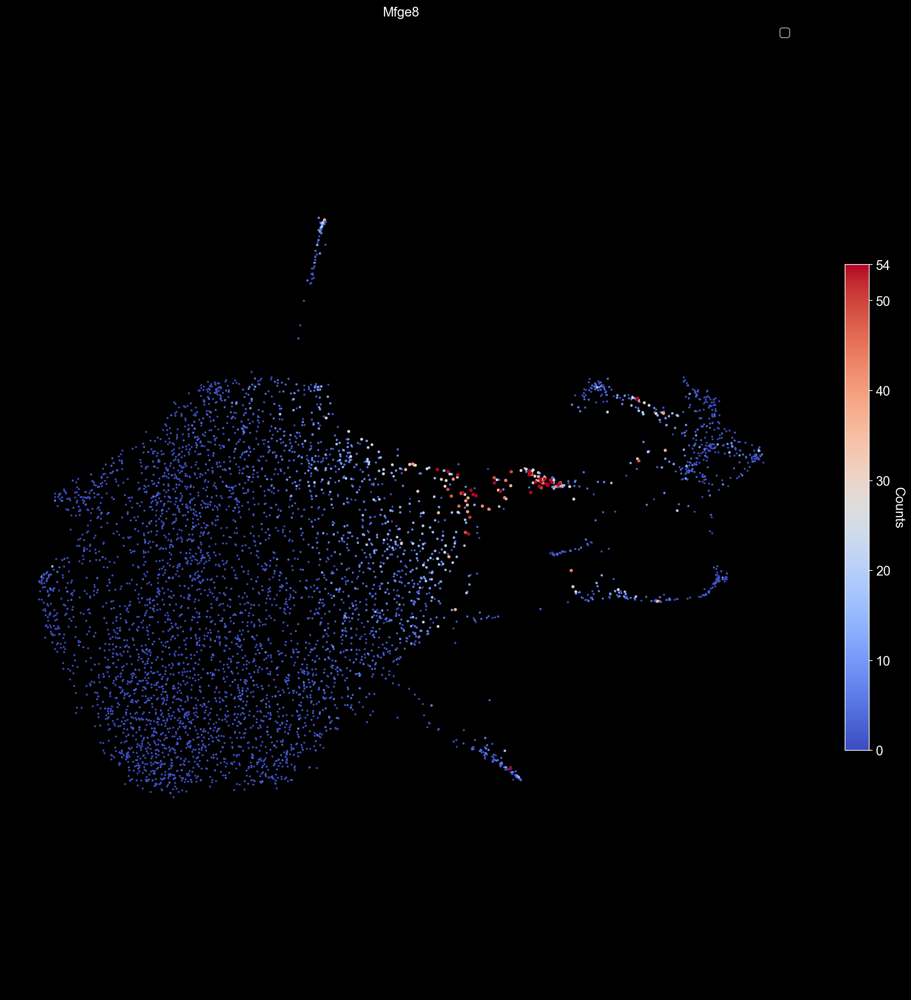

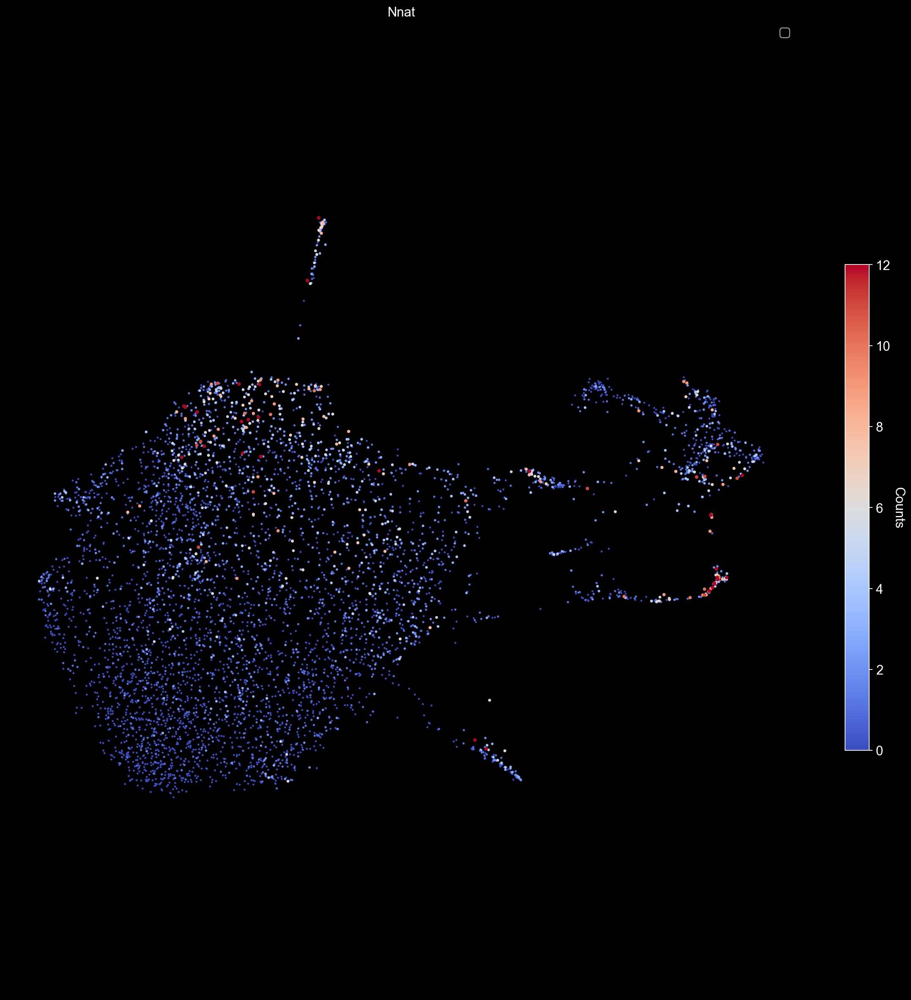

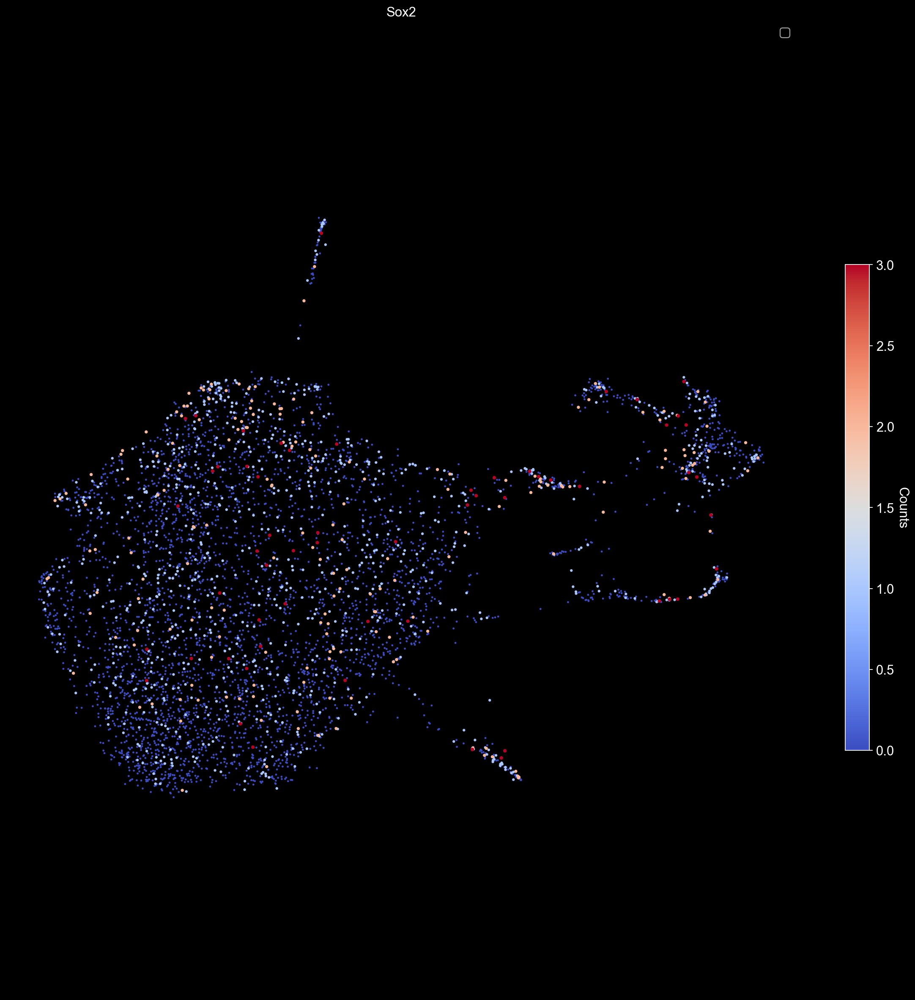

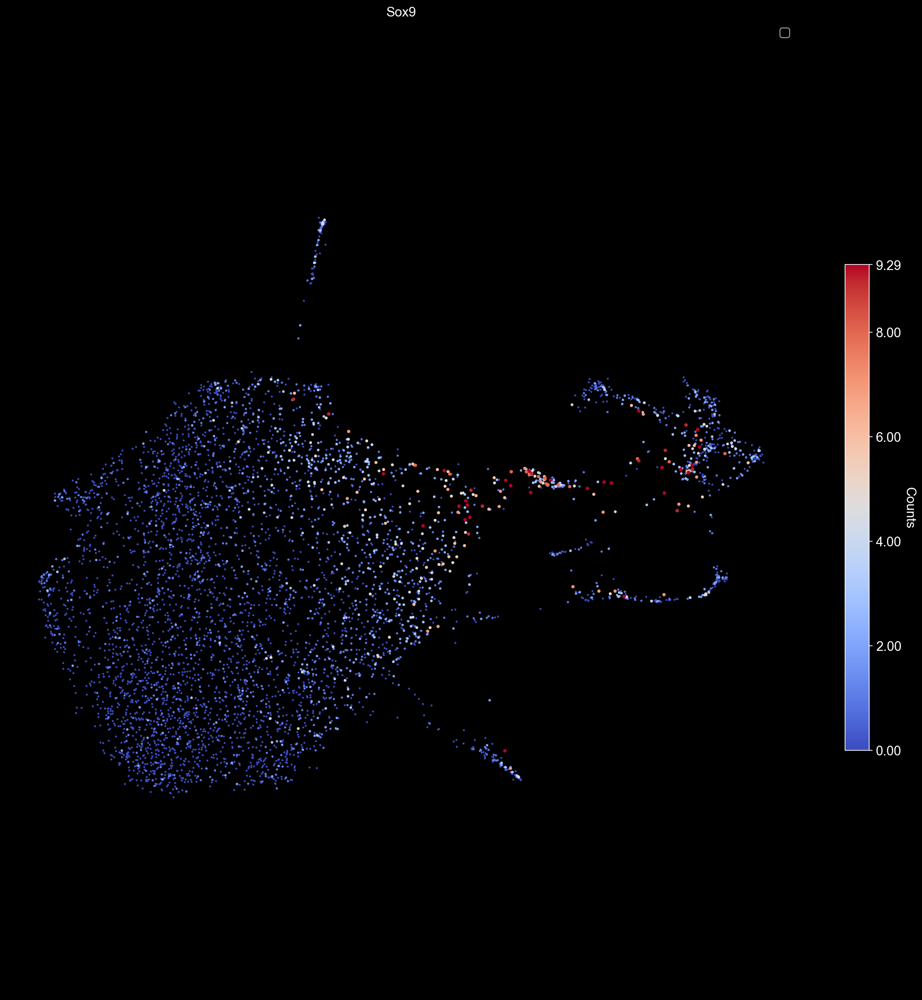

In [12]:
for gene in gene_list:
    adata_edu_pos.plot_gene_scdata(gene = gene, umap = True, percentile = 99.5)